# Spin Tomography

In [3]:
import matplotlib as mpl; import matplotlib.pyplot as plt
%matplotlib inline
#%matplotlib notebook
import os
import pickle
from mpl_toolkits.mplot3d import Axes3D
import time
import numpy as np
%load_ext line_profiler

The line_profiler extension is already loaded. To reload it, use:
  %reload_ext line_profiler


In [16]:
import labmgt

ImportError: No module named labmgt

## Review (02-May-2017)

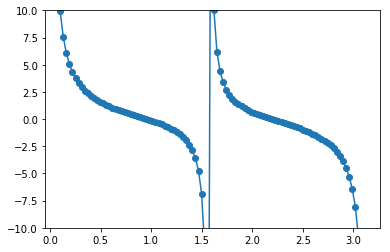

In [12]:
plt.figure()
thetas=np.linspace(0.1,np.pi*0.99,100);
plt.plot(thetas,(3.*np.cos(thetas)**2-1)/np.sin(2*thetas),'o-')
plt.ylim(-10,10)
plt.show()

## NV factory

In [8]:
from NV_generator import *

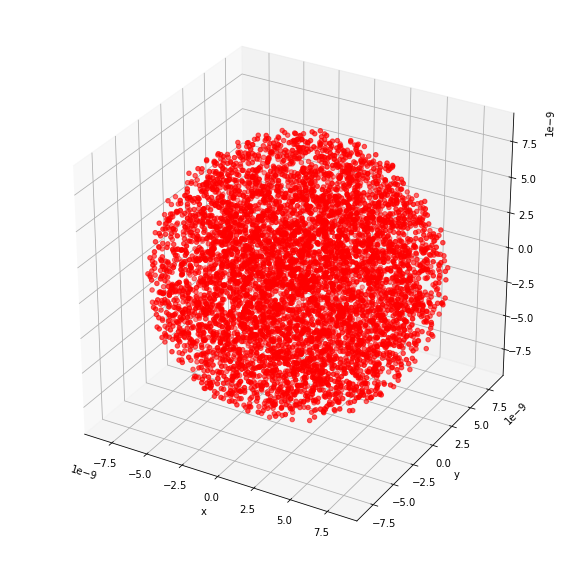

In [125]:
A1, B1, rs1, costheta1, sintheta1, carbon13_x1, carbon13_y1, carbon13_z1 = generate_NV(coords=True)
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(carbon13_x1,carbon13_y1,carbon13_z1,color='red')
#ax.scatter(cubicD_x[0],cubicD_y[0],cubicD_z[0])
plt.xlabel('x')
plt.ylabel('y')
ax.set_xlim(-a0*51/2,a0*51/2)
ax.set_ylim(-a0*51/2,a0*51/2)
ax.set_zlim(-a0*51/2,a0*51/2)
plt.show()

In [130]:
np.savetxt('/Users/juan/Dropbox/lat.csv',np.transpose(np.array([carbon13_x1,carbon13_y1,carbon13_z1])),delimiter=',')

## Sanity Checks

### Understanding M for a single C13

In [8]:
# Calculating by hand M for a single C13.
times = 10**(-6)*np.linspace(3,11,5000)
B1 = 25.308*1000*2*pi;
A1 = -37.884*1000*2*pi;
B_field = 0.0403555 # Teslas
gam_c = 67.262 * 10 ** 6 # Gyromagnetic ratio for a single c13 nucleus in rad s-1 T-1
ms = 1.
N = 64.
omega_larmor = -1 * ms * gam_c * B_field
beta = omega_larmor * times
omega_tilde = np.sqrt((A1+omega_larmor)**2+B1**2)
alpha_1 = omega_tilde * times
mz1 = (A1+omega_larmor) /  omega_tilde
phi_1 =  np.arccos( np.cos(alpha_1)*np.cos(beta) - mz1*np.sin(alpha_1)*np.sin(beta) )
mx1 = B1/omega_tilde;
x1 = mx1**2 *(1-np.cos(alpha_1))*(1.-np.cos(beta))/(1.+np.cos(phi_1))
M = 1 - x1*np.sin(N/2 * phi_1)**2

I checked and this gives an identical return to the corresponding
function in Michael's code.
The following is just figure 3.1 in Michael's thesis.

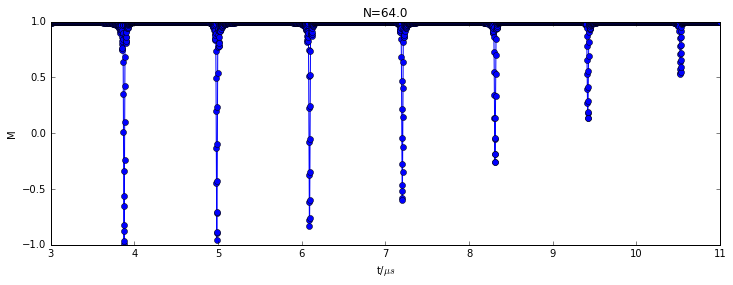

In [9]:
plt.figure(figsize=(12,4))
plt.plot(10**6*times,M,'o-')
plt.ylim(-1,1)
plt.xlabel('t/$\mu s$')
plt.ylabel('M')
plt.title('N='+str(N))
plt.show()

How does the signal vary with N?

In [54]:
plt.figure(figsize=(100,100))
#plt.plot(10**6*times,calc_M_single(A1,B1,64,omega_larmor,times),'o')
for thisN in range(1,101):
    N = thisN
    print(str(thisN)),
    #print(str(thisN)+" ",end='')
    plt.subplot(10,10,thisN)
    omega_larmor = -1 * ms * gam_c * B_field
    beta = omega_larmor * times
    omega_tilde = np.sqrt((A1+omega_larmor)**2+B1**2)
    alpha_1 = omega_tilde * times
    mz1 = (A1+omega_larmor) /  omega_tilde
    phi_1 =  np.arccos( np.cos(alpha_1)*np.cos(beta) - mz1*np.sin(alpha_1)*np.sin(beta) )
    mx1 = B1/omega_tilde;
    x1 = mx1**2 *(1-np.cos(alpha_1))*(1.-np.cos(beta))/(1.+np.cos(phi_1))
    M = 1 - x1*np.sin(N/2 * phi_1)**2
    plt.plot(10**6*times,M,'o-')
    plt.ylim(-1,1)
    plt.xlabel('t/$\mu s$')
    plt.ylabel('M')
    plt.title('N='+str(N))
plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)
    #plt.figtext(1,1,'N='+str(thisN))
plt.show()

1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100

Reproduce fig 3.3.

In [18]:
numspins=480; # Approx
spins=generate_spins(numspins);
As=spins[0];
Bs=spins[1];

In [20]:
# Calculating by hand M for a bunch of C13s
times = 10**(-6)*np.linspace(3,11,5000)
M=np.ones(len(times))
B_field = 0.0403555 # Teslas
gam_c = 67.262 * 10 ** 6 # Gyromagnetic ratio for a single c13 nucleus in rad s-1 T-1
ms = 1.
N = 64.
omega_larmor = -1 * ms * gam_c * B_field
beta = omega_larmor * times
for i in range(len(As)):
    B1 =Bs[i];
    A1 = As[i];
    omega_tilde = np.sqrt((A1+omega_larmor)**2+B1**2)
    alpha_1 = omega_tilde * times
    mz1 = (A1+omega_larmor) /  omega_tilde
    phi_1 =  np.arccos( np.cos(alpha_1)*np.cos(beta) - mz1*np.sin(alpha_1)*np.sin(beta) )
    mx1 = B1/omega_tilde;
    x1 = mx1**2 *(1-np.cos(alpha_1))*(1.-np.cos(beta))/(1.+np.cos(phi_1))
    thisM = 1 - x1*np.sin(N/2 * phi_1)**2
    M = M*thisM

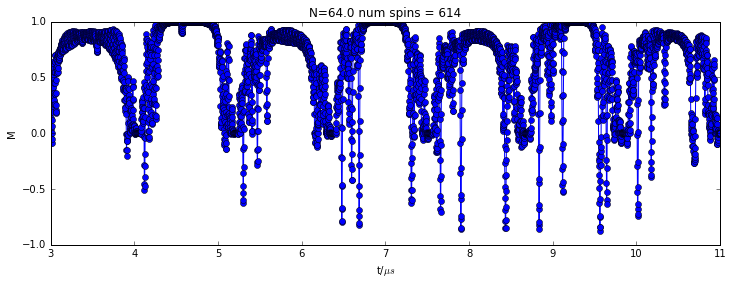

In [21]:
plt.figure(figsize=(12,4))
plt.plot(10**6*times,M,'o-')
plt.ylim(-1,1)
plt.xlabel('t/$\mu s$')
plt.ylabel('M')
plt.title('N='+str(N)+' num spins = '+str(len(As)))
plt.show()

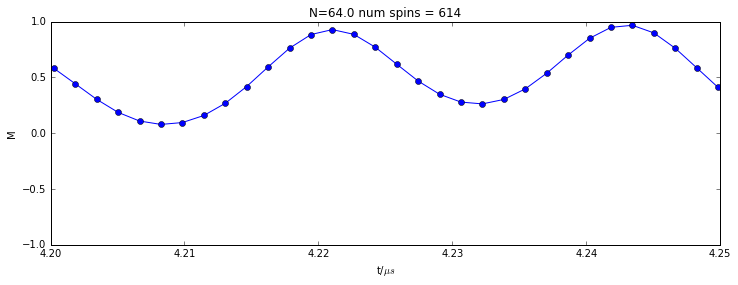

In [22]:
plt.figure(figsize=(12,4))
plt.plot(10**6*times,M,'o-')
plt.ylim(-1,1)
plt.xlabel('t/$\mu s$')
plt.ylabel('M')
plt.title('N='+str(N)+' num spins = '+str(len(As)))
plt.xlim(4.2,4.25)
plt.show()

Now fix a time and vary N. Figure 4.1. In this case I'll set the time at 4.22 μs

In [23]:
time = 4.22 * 10**(-6)
Ns = range(1,250)
Ms=np.zeros(len(Ns))
B_field = 0.0403555 # Teslas
gam_c = 67.262 * 10 ** 6 # Gyromagnetic ratio for a single c13 nucleus in rad s-1 T-1
ms = 1.
N = 64.
omega_larmor = -1 * ms * gam_c * B_field
beta = omega_larmor * time
counter = 0
for N in Ns:
    M=1
    for i in range(len(As)):
        B1 =Bs[i];
        A1 = As[i];
        omega_tilde = np.sqrt((A1+omega_larmor)**2+B1**2)
        alpha_1 = omega_tilde * time
        mz1 = (A1+omega_larmor) /  omega_tilde
        phi_1 =  np.arccos( np.cos(alpha_1)*np.cos(beta) - mz1*np.sin(alpha_1)*np.sin(beta) )
        mx1 = B1/omega_tilde;
        x1 = mx1**2 *(1-np.cos(alpha_1))*(1.-np.cos(beta))/(1.+np.cos(phi_1))
        thisM = 1 - x1*np.sin(N/2 * phi_1)**2
        M = M*thisM
    Ms[counter] = M
    counter = counter+1

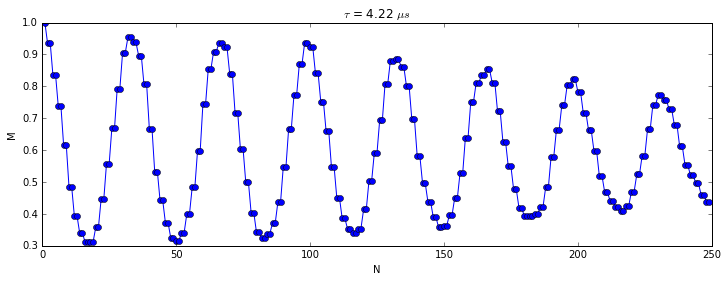

In [24]:
plt.figure(figsize=(12,4))
plt.plot(Ns,Ms,'o-')
plt.xlabel('N')
plt.ylabel('M')
plt.title('$\\tau$ = '+str(10**6*time)+' $\\mu s$')
plt.show()

In [135]:
pi/(omega_larmor)*10**6

-1.1618022642179313

Calculate the entire surface and make a surface plot.

In [25]:
len(As)

614

In [53]:
#%%time
# Calculating by hand M for a bunch of C13s
# Varying N
Ns = range(1,568);
# times = 10**(-6)*np.linspace(3,11,5000)
times = 10**(-6)*np.linspace(3,7,4000)
Mtsurf = np.zeros((len(Ns),len(times)))
counter = 0
for N in Ns:
    print(N),
    M=np.ones(len(times))
    B_field = 0.0404 #3555 # Teslas
    gam_c = 67.262 * 10 ** 6 # Gyromagnetic ratio for a single c13 nucleus in rad s-1 T-1
    ms = 1.
    omega_larmor = -1 * ms * gam_c * B_field
    beta = omega_larmor * times
    for i in range(len(As)):
        B1 =Bs[i];
        A1 = As[i];
        omega_tilde = np.sqrt((A1+omega_larmor)**2+B1**2)
        alpha_1 = omega_tilde * times
        mz1 = (A1+omega_larmor) /  omega_tilde
        phi_1 =  np.arccos( np.cos(alpha_1)*np.cos(beta) - mz1*np.sin(alpha_1)*np.sin(beta) )
        mx1 = B1/omega_tilde;
        x1 = mx1**2 *(1.-np.cos(alpha_1))*(1.-np.cos(beta))/(1.+np.cos(phi_1))
        thisM = 1 - x1*np.sin(N/2. * phi_1)**2
        M = M*thisM
    Mtsurf[counter] = M
    counter = counter + 1

1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 277 

In [51]:
len(As)

566

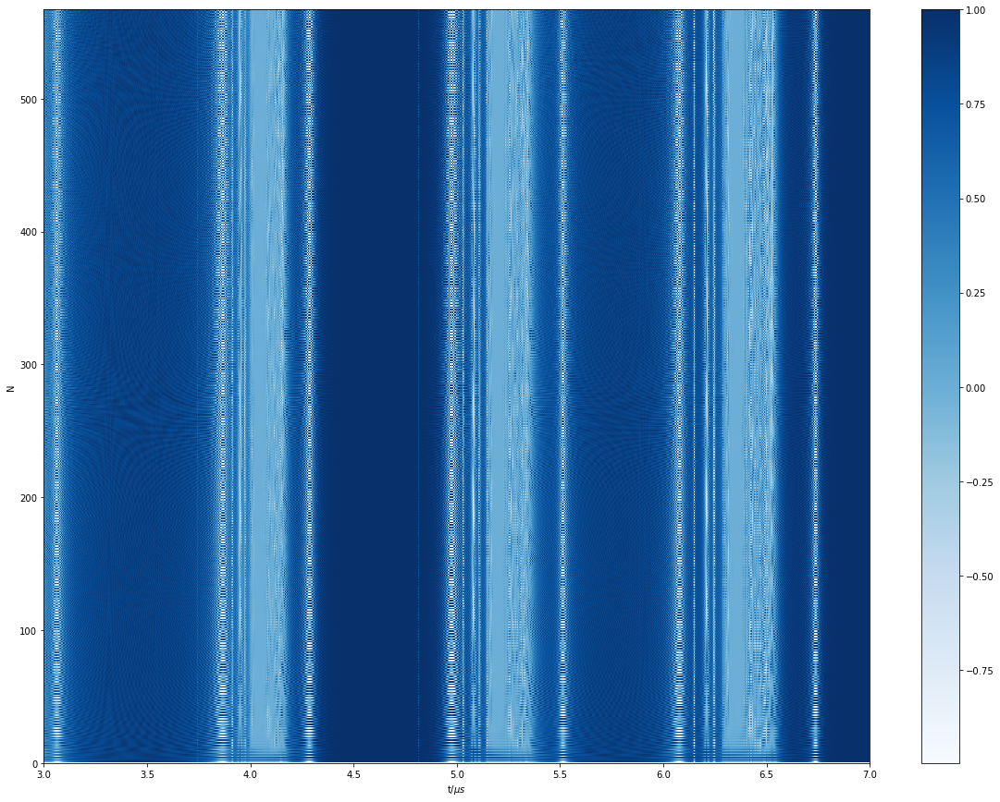

In [54]:
plt.figure(figsize=(20,15))
plt.pcolormesh(10**6*times, Ns, Mtsurf,cmap=plt.cm.get_cmap('Blues'))
plt.ylim(0,len(Ns))
plt.xlabel('t/$\\mu s$')
plt.ylabel('N')
plt.colorbar()
#plt.savefig('/Users/juan/Desktop/map2.png')
plt.show()

In [1]:
# 17-Apr-2017
# Is it foolish to attempt a global fit from the very beginning?
# If one were to detect, say 15 weakly coupled carbon 13 nuclei, these would be embedded
# in about 1500 other nuclei.
# The ways in which these can be chosen from the set is about
# 3 * 10**35.
# This is a lot. How much is a lot?

# Say that each possibility could be defined by 1 MB.
# This would mean a search space of 3 E32 Gb.
# By comparison the storage space required for Google's index
# is about 10**5 Gb.

# This is why the first step, that of analyzing the individual resonances
# is so important. It greatly reduces the search space.
# However, is this the best procedure?

# This brings to mind an interesting idea, 
# what characterizes regions of a search space
# that are more amicable to regression?

# By extension, how big a search index would I be able to
# handle in my computer? What if I had other resources
# available?

In [ ]:
# Consider, what is the effect of changing the magnetic field?
# Is there a "magic magnetic field"? One that allows for 
# easier fitting somehow?

## How much memory a numpy array requires?

$$8 N$$ (In bytes. For flot64 elements. N of them.)

In [107]:
sizes = []
elements = range(1,10**5,100)
for i in elements:
    arr = np.random.rand(i)
    sizes.append(arr.nbytes)

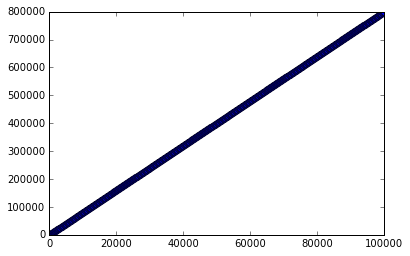

In [108]:
plt.figure()
plt.plot(elements,sizes,'o')
plt.show()

In [101]:
(1000*1000*1000)/8.

125000000.0

In [105]:
biga = np.random.rand(125*10**6);
biga.reshape((500,500,500));

In [106]:
biga.nbytes

1000000000

## Making a stack

In [10]:
Ns = range(1,501);
B_fields = np.linspace(0.040,0.060,500)
times = 10**(-6)*np.linspace(3,11,5000)
#stack = np.zeros((len(B_fields),len(Ns),len(times)))

In [37]:
def save_stack(num):
    root_dir = '/Users/juan/Google Drive/Zia Lab/NV-spin-tomography-data/stack/'
    root_dir = './'
    pickle.dump(Mtsurf, open(root_dir+'stack-'+str(num)+'.pickle','wb'))

In [48]:
# Generate a set of As and Bs.
# Choose N
# Initialize M
# Iterate through N
spins=generate_spins(numspins);
As=spins[0];
Bs=spins[1];
numspins=480;  # Approx

contador = 0
for i in range(len(B_fields)): # This loop is for a set of spins
    print(str(contador)+(' - ')),
    Mtsurf = np.zeros((len(Ns),len(times)));
    counter = 0;
    B_field =B_fields[contador]; # Teslas
    gam_c = 67.262 * 10 ** 6; # Gyromagnetic ratio for a single c13 nucleus in rad s-1 T-1
    ms = 1.;
    omega_larmor = -1. * ms * gam_c * B_field;
    beta = omega_larmor * times;
    M=np.ones(len(times));
    for N in Ns: # This loop is for creating
        for i in range(len(As)):
            B1 = Bs[i];
            A1 = As[i];
            omega_tilde = np.sqrt((A1+omega_larmor)**2+B1**2);
            alpha_1 = omega_tilde * times;
            mz1 = ( A1 + omega_larmor ) /  omega_tilde;
            phi_1 =  np.arccos( np.cos(alpha_1)*np.cos(beta) - mz1*np.sin(alpha_1)*np.sin(beta) )
            mx1 = B1/omega_tilde;
            x1 = mx1**2 *(1.-np.cos(alpha_1))*(1.-np.cos(beta))/(1.+np.cos(phi_1))
            thisM = 1. - x1*np.sin(N/2. * phi_1)**2
            M = M*thisM
        Mtsurf[counter] = M
        counter = counter + 1
    save_stack(contador)
    contador = contador + 1
    if contador == 2:
        print("bye")
        break
   #print('*****')

0 -  1 -  bye


## Looking at a stack

In [ ]:
def save_stack(num):
    root_dir = '/Users/juan/Google Drive/Zia Lab/NV-spin-tomography-data/stack/'
    root_dir = './'
    pickle.dump(Mtsurf, open(root_dir+'stack-'+str(num)+'.pickle','wb'))

In [55]:
def load_stack(num):
    root_dir = '/Users/juan/Google Drive/Zia Lab/NV-spin-tomography-data/stack/'
    root_dir = './'
    return pickle.load(open(root_dir+'stack-'+str(num)+'.pickle','rb'))

In [58]:
st = load_stack(1)

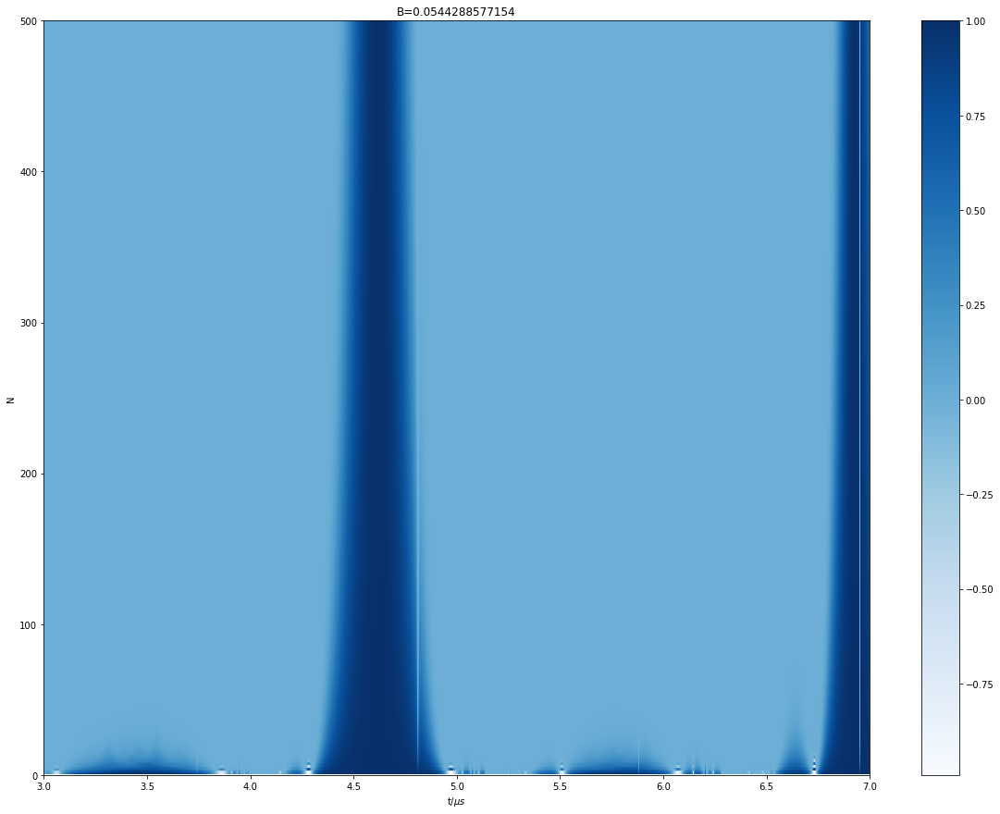

In [59]:
ene = 360;
#surf = load_stack(ene)
surf = st
Ns = range(1,501);
B_fields = np.linspace(0.040,0.060,500)
times = 10**(-6)*np.linspace(3,7,4000)
plt.figure(figsize=(20,15))
plt.pcolormesh(10**6*times, Ns, surf,cmap=plt.cm.get_cmap('Blues'))
plt.ylim(0,len(Ns))
plt.xlabel('t/$\\mu s$')
plt.ylabel('N')
plt.colorbar()
plt.title('B='+str(B_fields[ene]))
#plt.savefig('/Users/juan/Desktop/map2.png')
plt.show()

## Analyze dependence on B assuming uncertainty in last digit is 1

In [60]:
numspins=480; # Approx
spins=generate_spins(numspins);
As=spins[0];
Bs=spins[1];
Ns = range(1,568);
times = 10**(-6)*np.linspace(3,11,5000)
#times = 10**(-6)*np.linspace(3,7,4000)
sheets = [];
sheet = np.zeros((len(Ns),len(times)))
counter = 0
for N in Ns:
    print(N),
    M=np.ones(len(times))
    B_field = 0.04043555 # Teslas
    gam_c = 67.262 * 10 ** 6 # Gyromagnetic ratio for a single c13 nucleus in rad s-1 T-1
    ms = 1.
    omega_larmor = -1 * ms * gam_c * B_field
    beta = omega_larmor * times
    for i in range(len(As)):
        B1 =Bs[i];
        A1 = As[i];
        omega_tilde = np.sqrt((A1+omega_larmor)**2+B1**2)
        alpha_1 = omega_tilde * times
        mz1 = (A1+omega_larmor) /  omega_tilde
        phi_1 =  np.arccos( np.cos(alpha_1)*np.cos(beta) - mz1*np.sin(alpha_1)*np.sin(beta) )
        mx1 = B1/omega_tilde;
        x1 = mx1**2 *(1.-np.cos(alpha_1))*(1.-np.cos(beta))/(1.+np.cos(phi_1))
        thisM = 1 - x1*np.sin(N/2. * phi_1)**2
        M = M*thisM
    sheet[counter] = M
    counter = counter + 1
sheets.append(sheet)
sheet = np.zeros((len(Ns),len(times)))
counter = 0
for N in Ns:
    print(N),
    M=np.ones(len(times))
    B_field = 0.04043556 # Teslas
    gam_c = 67.262 * 10 ** 6 # Gyromagnetic ratio for a single c13 nucleus in rad s-1 T-1
    ms = 1.
    omega_larmor = -1 * ms * gam_c * B_field
    beta = omega_larmor * times
    for i in range(len(As)):
        B1 =Bs[i];
        A1 = As[i];
        omega_tilde = np.sqrt((A1+omega_larmor)**2+B1**2)
        alpha_1 = omega_tilde * times
        mz1 = (A1+omega_larmor) /  omega_tilde
        phi_1 =  np.arccos( np.cos(alpha_1)*np.cos(beta) - mz1*np.sin(alpha_1)*np.sin(beta) )
        mx1 = B1/omega_tilde;
        x1 = mx1**2 *(1.-np.cos(alpha_1))*(1.-np.cos(beta))/(1.+np.cos(phi_1))
        thisM = 1 - x1*np.sin(N/2. * phi_1)**2
        M = M*thisM
    sheet[counter] = M
    counter = counter + 1
sheets.append(sheet)
sheet = np.zeros((len(Ns),len(times)))
counter = 0
for N in Ns:
    print(N),
    M=np.ones(len(times))
    B_field = 0.04043554 # Teslas
    gam_c = 67.262 * 10 ** 6 # Gyromagnetic ratio for a single c13 nucleus in rad s-1 T-1
    ms = 1.
    omega_larmor = -1 * ms * gam_c * B_field
    beta = omega_larmor * times
    for i in range(len(As)):
        B1 =Bs[i];
        A1 = As[i];
        omega_tilde = np.sqrt((A1+omega_larmor)**2+B1**2)
        alpha_1 = omega_tilde * times
        mz1 = (A1+omega_larmor) /  omega_tilde
        phi_1 =  np.arccos( np.cos(alpha_1)*np.cos(beta) - mz1*np.sin(alpha_1)*np.sin(beta) )
        mx1 = B1/omega_tilde;
        x1 = mx1**2 *(1.-np.cos(alpha_1))*(1.-np.cos(beta))/(1.+np.cos(phi_1))
        thisM = 1 - x1*np.sin(N/2. * phi_1)**2
        M = M*thisM
    sheet[counter] = M
    counter = counter + 1
sheets.append(sheet)

1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 277 

In [79]:
pickle.dump(sheets[0], open('./b-uncertain-0.pickle','wb'))
pickle.dump(sheets[1], open('./b-uncertain-1.pickle','wb'))
pickle.dump(sheets[2], open('./b-uncertain-2.pickle','wb'))

In [140]:
len(sheets)

3

In [141]:
np.savetxt('sample-0.csv',sheets[0],delimiter=',')

In [142]:
np.savetxt('sample-1.csv',sheets[1],delimiter=',')

In [143]:
np.savetxt('sample-2.csv',sheets[2],delimiter=',')

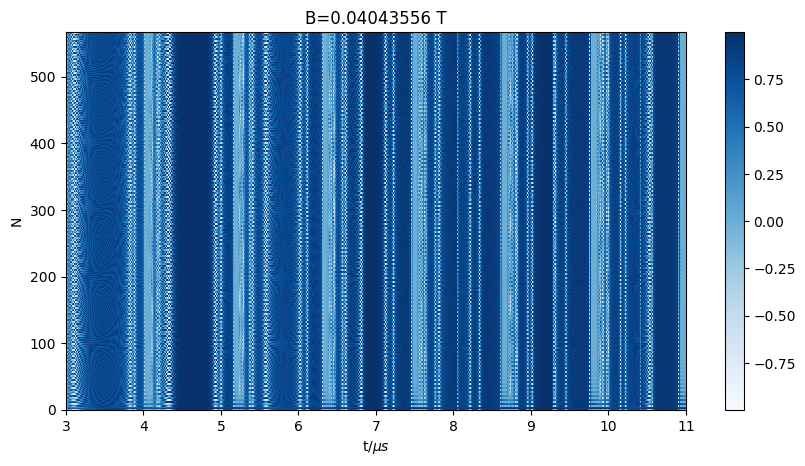

In [103]:
#surf = load_stack(ene)
surf = sheets[1]
Ns = range(1,568);
times = 10**(-6)*np.linspace(3,11,5000)
plt.figure(figsize=(10,5),dpi=100)
plt.pcolormesh(10**6*times, Ns, surf,cmap=plt.cm.get_cmap('Blues'))
plt.ylim(0,len(Ns))
plt.xlabel('t/$\\mu s$')
plt.ylabel('N')
plt.colorbar()
plt.title('B=0.04043556 T')
plt.savefig('/Users/juan/Desktop/b1.png',dpi=700,bbox_inches='tight', pad_inches=0)
plt.show()

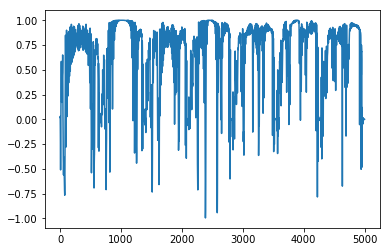

In [116]:
plt.figure()
plt.plot(surf[64])
plt.show()

0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 27

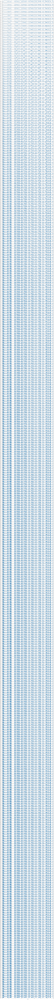

In [124]:
#surf = load_stack(ene)
surf = sheets[1]
Ns = range(1,568);
times = 10**(-6)*np.linspace(3,11,5000)
plt.figure(figsize=(20,400))
for i in range(len(Ns)):#len(Ns)):
    print(i),
    plt.subplot(len(Ns),1,i+1)
    plt.plot(10**6*times, surf[i])
    #plt.ylim(0,len(Ns))
    plt.xlim(3,11)
    plt.ylim(-1,1)
    plt.xlabel('t/$\\mu s$')
    plt.ylabel('(N='+str(Ns[i])+')\nM')
#plt.title('B='+str(B_fields[ene]))
plt.savefig('/Users/juan/Desktop/long_panel.pdf',bbox_inches='tight', pad_inches=0)
plt.show()

## Trying again to make the stack

In [ ]:
import pickle
from NV_generator import *

def save_stack(num):
    root_dir = './stack/'
    pickle.dump(sheet, open(root_dir+'stack-'+str(num)+'.pickle','wb'))

try:
    spins = pickle.load(open('./stack/spins.pickle','rb'))
    As=spins[0];
    Bs=spins[1];
except:
    numspins=480; # Approx
    spins=generate_spins(numspins);
    As=spins[0];
    Bs=spins[1];
    pickle.dump(spins,open('./stack/spins.pickle','wb'))

Ns = range(1,550);
times = 10**(-6)*np.linspace(3,11,5000)
B_fields = np.linspace(0.04,0.05,500);
contador = 0 # To reference each magnetic field
for k in range(len(B_fields)):
    sheet = np.zeros((len(Ns),len(times)))
    counter = 0;
    print(' - '+str(k)+' - ')
    for N in Ns:
        #if N%100 == 1:
        #    print(N),
        M=np.ones(len(times))
        B_field = B_fields[k] # Teslas
        gam_c = 67.262 * 10 ** 6 # Gyromagnetic ratio for a single c13 nucleus in rad s-1 T-1
        ms = 1.
        omega_larmor = -1 * ms * gam_c * B_field
        beta = omega_larmor * times
        for i in range(len(As)):
            B1 =Bs[i];
            A1 = As[i];
            omega_tilde = np.sqrt((A1+omega_larmor)**2+B1**2)
            alpha_1 = omega_tilde * times
            mz1 = (A1+omega_larmor) /  omega_tilde
            phi_1 =  np.arccos( np.cos(alpha_1)*np.cos(beta) - mz1*np.sin(alpha_1)*np.sin(beta) )
            mx1 = B1/omega_tilde;
            x1 = mx1**2 *(1.-np.cos(alpha_1))*(1.-np.cos(beta))/(1.+np.cos(phi_1))
            thisM = 1 - x1*np.sin(N/2. * phi_1)**2
            M = M*thisM
        sheet[counter] = M
        counter = counter + 1
    save_stack(k)

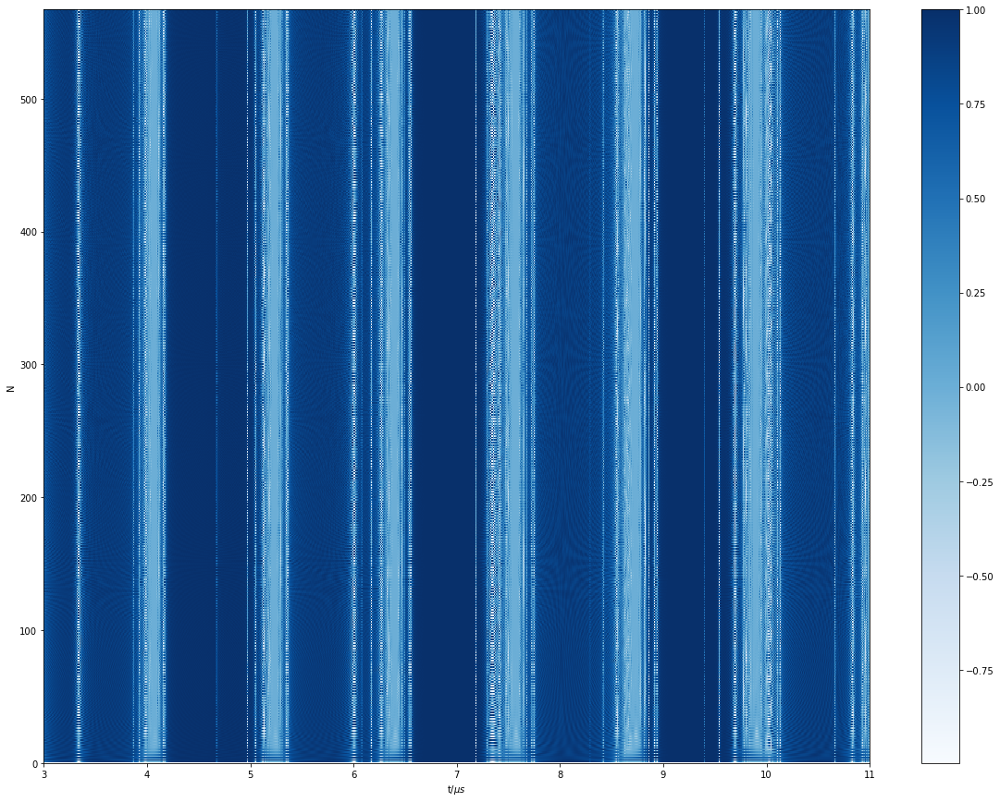

In [84]:
#surf = load_stack(ene)
surf = load_stack(1)
plt.figure(figsize=(20,15))
plt.pcolormesh(10**6*times, Ns, surf,cmap=plt.cm.get_cmap('Blues'))
plt.ylim(0,len(Ns))
plt.xlabel('t/$\\mu s$')
plt.ylabel('N')
plt.colorbar()
#plt.title('B='+str(B_fields[ene]))
#plt.savefig('/Users/juan/Desktop/map2.png')
plt.show()

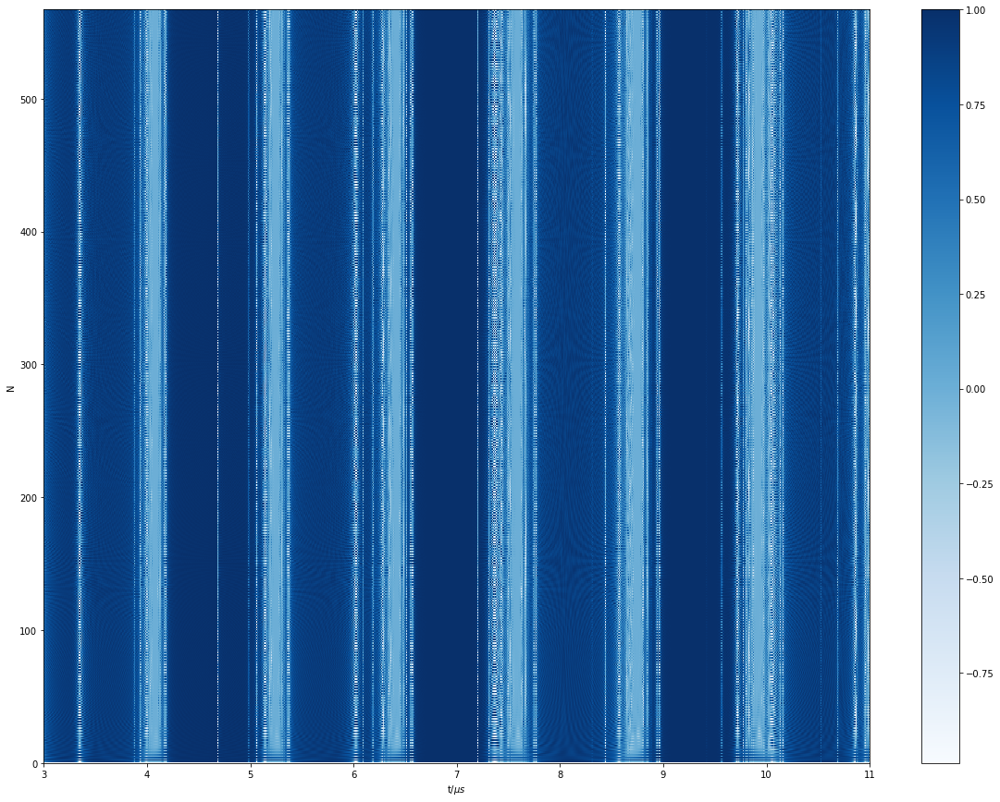

In [83]:
#surf = load_stack(ene)
surf = load_stack(0)
plt.figure(figsize=(20,15))
plt.pcolormesh(10**6*times, Ns, surf,cmap=plt.cm.get_cmap('Blues'))
plt.ylim(0,len(Ns))
plt.xlabel('t/$\\mu s$')
plt.ylabel('N')
plt.colorbar()
#plt.title('B='+str(B_fields[ene]))
#plt.savefig('/Users/juan/Desktop/map2.png')
plt.show()

## Create datasets and classifiers

In [ ]:
# Michael's code for learning.py

# NV-spin-tomography Michael Scheer mgscheer@gmail.com

# Creating datasets and training classifiers, storing objects on disk

import numpy as np
import sklearn as sk
from sklearn import svm, preprocessing, cross_validation, cluster, metrics
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.externals import joblib
import analysis
import NV_generator

# store an object in a file
def store_obj(obj, fname):
    joblib.dump(obj, fname + ".pkl")

# load an object from a file
def load_obj(fname):
    return joblib.load(fname + ".pkl")

# decides if a fitted A and B are close enough to a spin to be counted as a fit.
# the B tends to be harder to fit so the accuracy demanded is less.
def is_fit(fitted_A, fitted_B, spin, A_acc = .1, B_acc = .5):
    A_acc = analysis.mag * A_acc
    B_acc= analysis.mag * B_acc
    return ((spin[0] >= fitted_A - A_acc) and (spin[0] <= fitted_A + A_acc) and
        (spin[1] >= fitted_B - B_acc) and (spin[1] <= fitted_B + B_acc))

# creates a dataset of diamonds with N measurements already analyzed, saves it to disk
def create_diamonds(diamond_num_list, omega_larmor, num_spins = 450):
    verbose, plots = False, False
    num_subsets = 4
    error_fun = analysis.squared_error
    error_tol = .1/64
    N = 64
    N_vals = np.arange(0, 256, 2)
    tau = analysis.choose_tau_params(N) # these are the free-evolution times
    for diamond_num in diamond_num_list: # diamond_num_list are just numbers to reference the diamond samples
        print "diamond_num: ", diamond_num
        A, B, r, costheta, sintheta = NV_generator.generate_spins(num_spins)
        def data_func(N, tau, noise_level = .02):
            data = analysis.calc_M(A, B, N, omega_larmor, tau)
            noise = np.random.randn(len(data)) * noise_level
            return data + noise
        data = data_func(N, tau)
        dip_inds, windows = analysis.find_resonances(data, fit_dips_below = None)
        successful_fits, good_fits, phis_list, xs_list, scaled_errors = [], [], [], [], []
        print "number of dips: ", len(dip_inds)
        for dii in range(len(dip_inds)):
            print "dii: ", dii
            dip_ind = dip_inds[dii]
            res_tau = tau[dip_ind]
            N_data = data_func(N_vals, res_tau)
            successful_fit, good_fit = True, True # did the fit succeed without throwing an error? was the error in the fit small enough?
            try:
                phis, xs, scaled_error = analysis.repeated_spin_fit(N_vals, N_data, error_tol = error_tol, error_fun = error_fun,
                    num_subsets = num_subsets, verbose = verbose, plots = plots)
                good_fit = scaled_error <= error_tol
            except analysis.FitError:
                successful_fit, good_fit = False, False
                phis, xs = None, None
                scaled_error = None
            successful_fits.append(successful_fit)
            good_fits.append(good_fit)
            phis_list.append(phis)
            xs_list.append(xs)
            scaled_errors.append(scaled_errors)
        print "create diamond_dict"
        diamond_dict = {"A" : A, "B" : B, "r" : r, "costheta" : costheta, "sintheta" : sintheta, "N" : N,
            "tau" : tau, "data" : data, "N_vals" : N_vals, "N_data" : N_data, "dip_inds" : dip_inds, "windows" : windows,
            "successful_fits" : successful_fits, "good_fits" : good_fits, "error_tol" : error_tol, "num_subsets" : num_subsets,
            "phis_list" : phis_list, "xs_list" : xs_list, "scaled_errors" : scaled_errors}
        print "store diamond_dict"
        store_obj(diamond_dict, "diamonds/diamond_" + str(diamond_num))

# train and optionally save a support vector machine classifier
# scaler preprocesses the data (scales it) and clf is the classifier
def train_svm(train_X, train_Y, test_X, test_Y, kernel = 'rbf', C=1.0, verbose = False, pickle = False, suffix = ""):
    scaler = sk.preprocessing.StandardScaler().fit(train_X)
    clf = sk.svm.SVC(kernel = kernel, C=C)# svm with rbf kernel (default)
    clf.fit(scaler.transform(train_X), train_Y)
    if verbose:
        print "training score: ", clf.score(scaler.transform(train_X), train_Y)
        print "testing score: ", clf.score(scaler.transform(test_X), test_Y)
    if pickle:
        store_obj(scaler, "classifiers/scaler_svm_" + kernel + suffix)
        store_obj(clf, "classifiers/clf_svm_" + kernel + suffix)
    return scaler, clf

# train and optionally save an extra-trees classifier
# scaler preprocesses the data (scales it) and clf is the classifier
def train_trees(train_X, train_Y, test_X, test_Y, verbose = False, pickle = False, suffix = ""):
    scaler = sk.preprocessing.StandardScaler().fit(train_X)
    clf = sk.ensemble.ExtraTreesClassifier(n_estimators=10, max_depth=None, min_samples_split=1, random_state=0)
    clf.fit(scaler.transform(train_X), train_Y)
    if verbose:
        print "training score: ", clf.score(scaler.transform(train_X), train_Y)
        print "testing score: ", clf.score(scaler.transform(test_X), test_Y)
    if pickle:
        store_obj(scaler, "classifiers/scaler_trees" + suffix)
        store_obj(clf, "classifiers/clf_trees" + suffix)
    return scaler, clf

# creates and optionally saves the dataset used to train the SVM which classifies guesses.
def guess_dataset(diamonds, omega_larmor, min_dip_ind = 3220, training_percent = .75, pickle = False, suffix = ""):
    train_X = [] # feature vectors
    train_Y = [] # classifications
    test_X = []
    test_Y = []
    error_fun = analysis.squared_error
    for diamond_ind in range(len(diamonds)):
        print "diamond_ind: ", diamond_ind
        diamond = diamonds[diamond_ind]
        tau = diamond["tau"]
        data = diamond["data"]
        N = diamond["N"]
        dip_inds = diamond["dip_inds"]
        windows = diamond["windows"]
        spin_dict = {}
        for dii in range(len(dip_inds)):
            if diamond["good_fits"][dii] and dip_inds[dii] >= min_dip_ind:
                dip_ind = dip_inds[dii]
                res_tau = tau[dip_ind]
                for phi, x in zip(diamond["phis_list"][dii], diamond["xs_list"][dii]):
                    for omega_tilde, cosphi in analysis.calc_omega_tilde(phi, x, res_tau, omega_larmor):
                        A, B = analysis.calc_A_B(cosphi, res_tau, omega_larmor, omega_tilde)
                        if analysis.valid_A_B(A, B):
                            if (dip_ind, phi, x) in spin_dict:
                                spin_dict[(dip_ind, phi, x)] += [(A, B, cosphi)]
                            else:
                                spin_dict[(dip_ind, phi, x)] = [(A, B, cosphi)]
        for k in spin_dict.keys():
            err = []
            for A, B, _ in spin_dict[k]:
                err.append(error_fun(analysis.calc_M_single(A, B, N, omega_larmor, tau), data))
            min_err_ind = np.argmin(err)
            best_A, best_B, best_cosphi = spin_dict[k][min_err_ind]
            best_err = err[min_err_ind]
            _, _, x = k
            features = [best_cosphi, x, best_A, best_B, best_err]
            tag = 0
            for spin in set(zip(diamond["A"], np.abs(diamond["B"]))):
                if is_fit(best_A, best_B, spin, A_acc = .5, B_acc = 2):
                    tag = 1
                    break
            if diamond_ind < training_percent * len(diamonds):
                train_X.append(features)
                train_Y.append(tag)
            else:
                test_X.append(features)
                test_Y.append(tag)
    if pickle:
        print "create dataset"
        dataset = {"train_X" : train_X, "train_Y" : train_Y, "test_X" : test_X, "test_Y" : test_Y}
        print "store dataset"
        store_obj(dataset, "datasets/guess_dataset" + suffix)
    return train_X, train_Y, test_X, test_Y

In [ ]:
# Michael's code for analysis.py

# NV-spin-tomography Michael Scheer mgscheer@gmail.com

# the main code for the analysis

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import scipy.optimize as opt
from scipy import special, fftpack, signal
import operator, heapq, itertools, warnings
import sklearn as sk
import learning

# frequency scale -- turns kHz into radial Hz. Used for printing paramaters nicely
mag = 2 * np.pi * 1e3

# a special error class that is thrown in this code when a fit does not work
class FitError(Exception):
    def __init__(self, value):
        self.value = value
    def __str__(self):
        return repr(self.value)

# create a nice looking plot
def initialize_data_plot(figsize = (10,5), xlims = None, ylims = [-1.05,1.05]):
    fig,ax = plt.subplots(figsize=figsize)
    ax.set_ylim(ylims)
    if xlims is not None:
        ax.set_xlim(xlims)
    return fig, ax

# calculates the M function for a single spin A, B
def calc_M_single(A,B,N,omega_larmor,tau):
    tau = np.array(tau)
    omega_tilde = np.sqrt((A + omega_larmor) ** 2 + B ** 2)
    mx = B/omega_tilde
    mz = (A+omega_larmor)/omega_tilde
    alpha = omega_tilde * tau
    beta = omega_larmor * tau
    cos_phi = np.cos(alpha) * np.cos(beta)- mz * np.sin(alpha) * np.sin(beta)
    vec_num = (mx ** 2) * (1-np.cos(alpha)) * (1-np.cos(beta))
    vec_denom = 1.0 + cos_phi
    for i in np.where(vec_denom == 0.0)[0]:
        vec_denom[i] = .0001
    vec_term = vec_num/vec_denom
    angle_term = np.sin(N * np.arccos(cos_phi) / 2.0) ** 2
    return 1 - (vec_term * angle_term)

# calculates the M function corresponding to many spins given by
# A_list, B_list
# equivalent to np.array([calc_M_single(A, B, N, omega_larmor, tau) for A, B in zip(A_list, B_list)]).prod()
def calc_M(A_list, B_list, N, omega_larmor, tau):
    return reduce(lambda accum, next: accum * calc_M_single(next[0], next[1], N, omega_larmor, tau), zip(A_list, B_list), 1.0)

# calculates what A and B must be given the value of cos(phi) as well as omega_tilde
def calc_A_B(cosphi, res_tau, omega_larmor, omega_tilde):
    alpha = omega_tilde * res_tau
    beta = omega_larmor * res_tau
    mz = (np.cos(alpha) * np.cos(beta) - cosphi)/(np.sin(alpha) * np.sin(beta))
    A = mz * omega_tilde - omega_larmor
    B = np.sqrt((1 - mz ** 2)) * omega_tilde
    return A, np.abs(B)

# Firm bounds on omega_tilde arising from an upper bound on hyperfine couplings
def omega_bounds(omega_larmor, coupling_bound = 150 * mag):
    upper_omega_bound = omega_larmor + coupling_bound
    lower_omega_bound = omega_larmor - coupling_bound
    return lower_omega_bound, upper_omega_bound

# checks if the A, B pair has a coupling larger than coupling_bound
def valid_A_B(A, B, coupling_bound = 150 * mag):
    return A ** 2 + B ** 2 <= coupling_bound ** 2

# for a real sequence y indexed by a sequence x,
# writes y = a0 + a1 * cos(omega_0 * x) + b1 * sin(omega_0 * x) + ...
# with omega_0 = 2 * np.pi/len(x)
# as a "fourier series" (though for discrete y not continuous) and finds (very approximately)
# the a and b coefficients.
# coefs.real = a0, a1, a2, ...
# coefs.imag = 0, -b1, -b2, ... (notice the negative signs)
# see http://www.feynmanlectures.caltech.edu/I_50.html for fourier series and
# http://docs.scipy.org/doc/scipy-0.16.1/reference/generated/scipy.fftpack.fft.html for the formula used for FFT.
# notice the 2/N difference between the two formulas for all but the 0 frequency term.
def sinusoid_coefs_fft(x, y):
    ft = fftpack.fft(y)
    freqs = fftpack.fftfreq(len(x), d = (x[1]-x[0])/(2*np.pi))
    # get rid of negative frequencies
    ft, freqs = map(np.array, zip(*filter(lambda p: p[1] >= 0, zip(ft, freqs))))
    coefs = 2.0 * np.array(ft)/len(x)
    coefs[0] = .5 * coefs[0]
    return coefs, freqs

# given the coefs and freqs from sinusoid_coefs_fft, finds the most likely frequencies
# present in the signal. It looks for peaks in both the real and imaginary part of the coefficients.
# it returns a list of frequencies in decreasing order of likelihood, based on the absolute value of the
# fourier spectrum (coefs) at that point.
def find_peaks_from_fourier(coefs, freqs):
    extremal_inds = signal.argrelextrema(coefs.real, np.greater)[0]
    extremal_inds = np.r_[extremal_inds, signal.argrelextrema(coefs.real, np.less)[0]]
    extremal_inds = np.r_[extremal_inds, signal.argrelextrema(coefs.imag, np.greater)[0]]
    extremal_inds = np.r_[extremal_inds, signal.argrelextrema(coefs.imag, np.less)[0]]
    extremal_inds = np.unique(extremal_inds)
    freq_inds = sorted(extremal_inds, key=lambda ind: -np.abs(coefs[ind]))
    return freqs[freq_inds]

# takes a list of frequencies that are peaks in a fourier spectrum, either of the real
# or imaginary part as well as a number of spins to look for. It then approximates the frequencies
# of the underlying product cosine functions that were in the signal. See appendix C of thesis.
def gen_freqs_from_fourier(freqs, num_spins):
    # sort them in decreasing order
    freqs = sorted(freqs, key=lambda x:-x)
    if num_spins == 1: # requires 1 freq
        return [freqs[0]]
    elif num_spins == 2: # requires 2 freqs
        f0, f1 = freqs[:2]
        return [.5 * (f0 + f1), .5 * (f0 - f1)]
    elif num_spins == 3: # requires 3 freqs
        f0, f1, f2 = freqs[:3]
        return [.5 * (f1 + f2), .5 * (f0 - f2), .5 * (f0 - f1)]
    elif num_spins == 4: # requires 5 freqs
        phi01sum, phi2, phi3 = gen_freqs_from_fourier(freqs[:4], 3)
        f3, f4 = freqs[3:5]        
        phi0 = .5 * (f3 + f4)
        phi1 = phi01sum - phi0
        return [phi0, phi1, phi2, phi3]
    else:
        return gen_freqs_from_fourier(freqs, 4) # change this if you figure out how to do 5

# the form of the signal as a function of N for a fixed tau
def spin_fit_fun_single(N, phi, x):
    return 1 - x * (np.sin(N * phi/2.0) ** 2)

# the form of the signal as a function of N for a fixed tau with several spins
# there can be any number of spins passed, in the form [phi0, phi1, ..., phin, x0, x1, ..., xn]
# where the function for a single spin is 1 - x * (np.sin(N * phi/2.0) ** 2)
# equivalent to np.array([single_spin_fit_fun(N, phi, x) for phi, x in zip(phis, xs)]).prod()
def spin_fit_fun(N, *args):
    num_spins = len(args)/2
    phis, xs = args[:num_spins], args[num_spins:2*num_spins]
    return reduce(lambda accum, next: accum * spin_fit_fun_single(N, next[0], next[1]), zip(phis, xs), 1.0)

# for two arrays l1 and l2 returns the squared error between them
def squared_error(l1, l2):
    return sum((l1 - l2) ** 2)

# Use scipy.optimize.curve_fit to fit N_data to several spins using fit_fun. Requires a guess of the spin
# parameters (phi's and x's) as param_guess
def spin_fit_guess(N_vals, N_data, num_spins, param_guess, error_fun = squared_error, fit_fun = spin_fit_fun):
    try:
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            popts, pcovs = opt.curve_fit(fit_fun, N_vals, N_data, p0 = param_guess)
        xs = popts[num_spins:2*num_spins]
        error = error_fun(fit_fun(N_vals, *popts), N_data)
        return popts, error, np.all((xs > 0) & (xs <= 2))
    except (RuntimeError, TypeError):
        raise FitError("Failed to fit spins with N data.")

# fit possibly several spins using a fit_fun to N_data
# for reference, see http://stackoverflow.com/questions/13405053/scipy-leastsq-fit-to-a-sine-wave-failing
# and appendix C of thesis.
def spin_fit(N_vals, N_data, error_fun = squared_error, verbose = True, plots = True, fit_fun = spin_fit_fun, extra_params = []):
    coefs, freqs = sinusoid_coefs_fft(N_vals, N_data)
    likely_freqs = find_peaks_from_fourier(coefs, freqs)
    params, errors, spins_found = [], [], []
    # the higest number of spins that can be fit with l frequencies
    def highest_spin(l):
        if l <= 3:
            return l
        elif l == 4:
            return 3
        else:
            return 4 # make this 5 if you figure out how to do 5
    for num_spins in range(1,1 + highest_spin(len(likely_freqs))):
        approx_phis = gen_freqs_from_fourier(likely_freqs, num_spins)
        approx_xs = num_spins * [2.0]
        p0s = approx_phis + approx_xs + extra_params[:num_spins]
        try:
            popts, error, valid = spin_fit_guess(N_vals, N_data, num_spins, p0s, error_fun = error_fun, fit_fun = fit_fun)
            if valid:
                params.append(popts)
                errors.append(error)
                spins_found.append(num_spins)
        except FitError:
            pass
    if not params:
        raise FitError("Failed to fit spins with N data.")
    else:
        ind = np.argmin(errors)
        if plots:
            plt.figure(figsize=(10,10))
            plt.plot(freqs, coefs.real, label = 'real part')
            plt.plot(freqs, coefs.imag, label = 'imag part')
            plt.title('Fourier spectrum')
            plt.xlabel('phi')
            plt.ylabel('Fourier coeficient')
            plt.legend()
            plt.show()
            plt.figure(figsize=(10,10))
            plt.plot(N_vals, N_data, '.-k', lw=0.4, label = 'data')
            plt.plot(N_vals, fit_fun(N_vals, *params[ind]), label = 'fit')
            plt.title('Fitted N data')
            plt.xlabel('N')
            plt.ylabel('M')
            plt.legend()
            plt.show()
        return params[ind], spins_found[ind]

# repeated attempts to fit N_vals and N_data using several spins. It tries subsets of the data of increasing length
# and then uses the best result as a guess for one final fit of the whole data. See appendix C of thesis for more detail.
def repeated_spin_fit(N_vals, N_data, error_fun = squared_error, num_subsets = 4,
    fit_fun = spin_fit_fun, extra_params = [], verbose = True, plots = True):
    spin_fits, scaled_errors = [], []
    for subset in [np.arange(int(len(N_vals) * r)) for r in np.linspace(0, 1, 1 + num_subsets)[1:]]:
        try:
            spin_ans = spin_fit(N_vals[subset], N_data[subset], error_fun = error_fun, fit_fun = fit_fun,
                extra_params = extra_params, verbose = verbose, plots = plots)
            spin_fits.append(spin_ans)
            scaled_errors.append(1.0 * error_fun(fit_fun(N_vals, *spin_ans[0]), N_data)/len(N_vals))
        except FitError:
            pass
    if not spin_fits:
        raise FitError("Failed to fit spins with N data.")
    min_ind = np.argmin(scaled_errors)
    popt_spin, num_spins = spin_fits[min_ind]
    if verbose:
        print "best before final pass: ", min_ind
        phis, xs = np.array(popt_spin[:num_spins]) % np.pi, np.array(popt_spin[num_spins:2*num_spins])
        phis, xs = map(np.array, zip(*sorted(zip(phis, xs), key = lambda x:-x[1])))# sort phis in decreasing order by xs
        print "answer before final pass: ", xs, phis
    try:
        popts, error, valid = spin_fit_guess(N_vals, N_data, num_spins, popt_spin, error_fun = error_fun, fit_fun = fit_fun)
        if valid:
            spin_fits.append((popts, num_spins))
            scaled_errors.append(1.0 * error_fun(fit_fun(N_vals, *popts), N_data)/len(N_vals))
            min_ind = np.argmin(scaled_errors)
            popt_spin, num_spins = spin_fits[min_ind]
        if plots:
            plt.figure(figsize = (10,10))
            plt.plot(N_vals, N_data, '.-k', lw=0.4, label = 'data')
            plt.plot(N_vals, fit_fun(N_vals, *popts), label = 'fit')
            plt.title('Fitted N data')
            plt.xlabel('N')
            plt.ylabel('M')
            plt.legend()
            plt.show()
    except FitError:
        pass
    if verbose:
        print "best overall: ", min_ind
        print scaled_errors
    scaled_error = scaled_errors[min_ind]
    phis, xs = np.array(popt_spin[:num_spins]) % np.pi, np.array(popt_spin[num_spins:2*num_spins])
    #phis, xs = map(np.array, zip(*sorted(zip(phis, xs), key = lambda x:-x[1])))# sort phis in decreasing order by xs
    return phis, xs, scaled_error    

# creates a tau vector that matches the tau from real data from Tim and Julia.
# should be filled in with realistic tau vectors for other N in the future.
def choose_tau_params(N, num_samples = 5100):
    if N != 64:
        raise FitError("N should be 64")
    else:
        min_tau = 3.0000000000000001e-06
        max_tau = 2.1999999999999999e-05
        length = num_samples
        tau = np.linspace(min_tau, max_tau, length)
        return tau

# finds local minima in the vector data as well as the intervals in which they are minima.
# only finds dips below fit_dips_below and less wide than max_width if the parameters are not None.
def find_resonances(data, fit_dips_below = None, max_width = None):
    min_inds = (signal.argrelextrema(data, np.less)[0]).astype(int)
    max_inds = (signal.argrelextrema(data, np.greater)[0]).astype(int)
    widths = max_inds[1:] - max_inds[:-1]
    dip_inds = min_inds[1:] if min_inds[0] < max_inds[0] else min_inds[:-1]
    windows = [(max_inds[i], max_inds[i+1]) for i in range(len(dip_inds)-1)] # should this be 3?
    # a dip must go below fit_dips_below, unless fit_dips_below = None and it's width should be at most max_width unless max_width = None
    filter_fun = lambda p: ((data[p[0]] < fit_dips_below) if (fit_dips_below != None) else True) and (p[1] <= max_width if max_width != None else True)
    dip_inds, widths, windows = map(np.array, zip(*filter(filter_fun, zip(dip_inds, widths, windows))))
    # sort by width
    # sort_inds = np.argsort(-1 * widths)
    # return dip_inds[sort_inds], windows[sort_inds]
    return dip_inds, windows

# Calculates all possible omega_tilde values for a given phi and x at a given res_tau.
# See chapter 4 of thesis.
def calc_omega_tilde(phi, x, res_tau, omega_larmor):
    beta = omega_larmor * res_tau
    cosbeta, cosphi_0 = np.cos(beta), np.cos(phi)
    lower_omega_bound, upper_omega_bound = omega_bounds(omega_larmor)
    omega_cosphi = []
    for cosphi in [cosphi_0, -cosphi_0]:
        prod = x * (1+cosbeta) * (1+cosphi)
        coeff = [1, prod - 2 * cosbeta * cosphi, prod + cosbeta ** 2 + cosphi ** 2 - 1]
        if coeff[1] ** 2 - 4 * coeff[0] * coeff[2] >= 0: # discriminant is nonnegative
            cosalphas = np.roots(coeff)
            for cosalpha in filter(lambda x: np.abs(x) <= 1, cosalphas):
                alpha_0_pi = np.arccos(cosalpha)
                for alpha_base in [alpha_0_pi, 2 * np.pi - alpha_0_pi]:
                    lower_int = int(np.ceil((lower_omega_bound * res_tau - alpha_base)/(2 * np.pi)))
                    upper_int = int(np.floor((upper_omega_bound * res_tau - alpha_base)/(2 * np.pi)))
                    for n in range(lower_int, upper_int + 1):
                        omega_cosphi.append(((alpha_base + 2 * np.pi * n)/res_tau, cosphi))
    return omega_cosphi

# for a given dip_ind, measures N data and fits it using repeated_spin_fit. If the fit error is less than error_tol,
# it finds all possible A and B values for each fit spin. Each possible A and B value that is within the bounds (is_valid)
# is added to spin_dict.
def analyze_dip(dip_ind, tau, data_func, omega_larmor, spin_dict = {}, error_tol = .1/64,
                N_vals = np.arange(0,256,2), error_fun = squared_error, fit_fun = spin_fit_fun, extra_params = [],
                num_subsets = 4, verbose = False, plots = False):
    res_tau = tau[dip_ind]
    N_data = data_func(N_vals, res_tau)
    try:
        phis, xs, scaled_error = repeated_spin_fit(N_vals, N_data, error_fun = error_fun, fit_fun = fit_fun, extra_params = extra_params,
            num_subsets = num_subsets, verbose = verbose, plots = plots)
    except FitError:
        if verbose:
            print "Failed to fit spins with N data."
        return spin_dict
    if verbose:
        print "res_tau: ", res_tau
        print "scaled_error <= error_tol: ", scaled_error <= error_tol
        print "scaled_error: ", scaled_error
        phis, xs = map(np.array, zip(*sorted(zip(phis, xs), key = lambda x:-x[1])))# sort phis in decreasing order by xs
        print "xs, phis, scaled_error: ", xs, phis, scaled_error
    if scaled_error > error_tol:
        return spin_dict
    for phi, x in zip(phis, xs):
        for omega_tilde, cosphi in calc_omega_tilde(phi, x, res_tau, omega_larmor): # all the possible omegas with their associated cosphis
            A, B = calc_A_B(cosphi, res_tau, omega_larmor, omega_tilde)
            if valid_A_B(A, B):
                if (dip_ind, phi, x) in spin_dict:
                    spin_dict[(dip_ind, phi, x)] += [(A, B, cosphi)]
                else:
                    spin_dict[(dip_ind, phi, x)] = [(A, B, cosphi)]
    return spin_dict

# takes in a dict of the type returned by analyze_dip and for each entry which represents a particular spin found at a particular dip
# it chooses the A, B value that minimizes the error_fun from the tau data. It returns these A and B guesses along with the calculated errors.
def choose_spin_guesses(spin_dict, N, omega_larmor, tau, data, classifier, x_min = 1, error_fun = squared_error):
    guess_As, guess_Bs, dataerrs = [], [], []
    all_guess_As, all_guess_Bs, select_As, select_Bs = [], [], [], []
    for k in spin_dict.keys():
        err = []
        for A, B, _ in spin_dict[k]:
            all_guess_As.append(A)
            all_guess_Bs.append(B)
            err.append(error_fun(calc_M_single(A, B, N, omega_larmor, tau), data))
        min_err_ind = np.argmin(err)
        best_A, best_B, best_cosphi = spin_dict[k][min_err_ind]
        select_As.append(best_A)
        select_Bs.append(best_B)
        best_err = err[min_err_ind]
        _, _, x = k
        features = [best_cosphi, x, best_A, best_B, best_err]
        if classifier(features) and x >= x_min:
            guess_As.append(best_A)
            guess_Bs.append(best_B)
            dataerrs.append(best_err)
    return (np.array(guess_As), np.array(guess_Bs), np.array(dataerrs),
        np.array(all_guess_As), np.array(all_guess_Bs), np.array(select_As), np.array(select_Bs))

# given guesses for As and Bs, clusters these guesses using the DBSCAN algorithm.
# for info about DBSCAN see http://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html
# for info about clustering with sklearn see http://scikit-learn.org/stable/modules/clustering.html#clustering
def cluster_spin_guesses(guess_As, guess_Bs, dataerrs, eps = .075, min_samples = 1):
    X = sk.preprocessing.StandardScaler().fit_transform(zip(guess_As, guess_Bs)) # possibly need to be lists?
    db = sk.cluster.DBSCAN(eps = eps, min_samples = min_samples).fit(X)
    labels = db.labels_
    cluster_As, cluster_Bs, cluster_dataerrs = [], [], []
    for k in np.unique(labels):
        if k >= 0:
            label_inds = np.where(labels == k)[0]
            best_guess = np.argmin(dataerrs[label_inds])
            cluster_As.append(guess_As[label_inds][best_guess])
            cluster_Bs.append(guess_Bs[label_inds][best_guess])
            cluster_dataerrs.append(dataerrs[label_inds][best_guess])
    return np.array(cluster_As), np.array(cluster_Bs), np.array(cluster_dataerrs)

# an approximation of the background due to the weakly coupled spins
#A_background = 4 * mag * (np.random.rand(400) - .5)
#B_background = 2 * mag * (np.random.rand(400))
#background_dict = {"A_background" : A_background, "B_background" : B_background}
#learning.store_obj(background_dict, "background_A_B")
background_dict = learning.load_obj("background_A_B")
A_background, B_background = background_dict["A_background"], background_dict["B_background"]

# given guess_As and guess_Bs, this function considers all ways of removing num_remove spins from the guess list
# it compares all of these possibilities along with not taking anything out in terms of the error from this subset to the data
# the error function considers the spins along with 400 weakly coupled spins which approximates the background.
# it returns the optimal subset as well as a number to remove next time: the same number if a spin was removed, otherwise the number
# considered for removal this time plus one (considering taking several out at the same time)
def remove_spins(guess_As, guess_Bs, N, omega_larmor, tau, data, num_remove = 1, error_fun = squared_error, verbose = False):
    # creates all subsets of s with size between lower and upper
    def subset_size_range(s, lower, upper):
        ans = []
        for i in range(lower, upper+1):
            for j in itertools.combinations(s, i):
                ans.append(j)
        return ans
    guess_As, guess_Bs = np.array(guess_As), np.array(guess_Bs)
    M_background = calc_M(A_background, B_background, N, omega_larmor, tau)
    err, As, Bs = [], [], []
    for subset in subset_size_range(range(len(guess_As)), len(guess_As) - num_remove, len(guess_As) - 1):
        subset = np.array(subset)
        err.append(error_fun(M_background * calc_M(guess_As[subset], guess_Bs[subset], N, omega_larmor, tau), data))
        As.append(guess_As[subset])
        Bs.append(guess_Bs[subset])
    best_ind = np.argmin(err)
    orig_error = error_fun(M_background * calc_M(guess_As, guess_Bs, N, omega_larmor, tau), data)
    if verbose:
        print "new error, old error: ", err[best_ind], orig_error
    if orig_error > err[best_ind]:
        return As[best_ind], Bs[best_ind], num_remove
    else:
        return guess_As, guess_Bs, num_remove + 1

# given a data function data_func(N, tau) that represents a diamond, returns an estimation
# of the hyperfine couplings of many c13s. The function returns, in order
# the final estimation, the total set of estimated parameters, the set remaining after using least squares,
# the set remaining after applying the classifier, and then the set after applying clustering. See chapter 4 of thesis.
def analyze_diamond(data_func, N, omega_larmor, kernel = "rbf", verbose = False, plots = False):
    tau = choose_tau_params(N)
    data = data_func(N, tau)
    dip_inds, windows = find_resonances(data, fit_dips_below = None)
    lower_ind_cutoff = 3220 # corresponds to 15 microseconds
    if verbose:
        print "number of dips to measure: ", sum(dip_inds >= lower_ind_cutoff)
    spin_dict = {}
    for dip_ind in dip_inds:
        if dip_ind >= lower_ind_cutoff: # 15 microseconds and on
            spin_dict = analyze_dip(dip_ind, tau, data_func, omega_larmor, spin_dict, N_vals = np.arange(0,256,2),
                error_tol = .1/64, verbose = verbose, plots = plots)
    # load the classifiers
    guess_scaler = learning.load_obj("classifiers/scaler_svm_" + kernel + "_di3220_29diamonds_cxABe")
    guess_clf = learning.load_obj("classifiers/clf_svm_" + kernel + "_di3220_29diamonds_cxABe")
    def guess_classifier(features):
        return guess_clf.predict(guess_scaler.transform([features]))
    guess_As, guess_Bs, dataerrs, all_guess_As, all_guess_Bs, select_As, select_Bs = choose_spin_guesses(spin_dict, N, omega_larmor, tau, data, guess_classifier, x_min = 1, error_fun = squared_error)
    cluster_As, cluster_Bs, cluster_dataerrs = cluster_spin_guesses(guess_As, guess_Bs, dataerrs, eps = .075, min_samples = 1)
    As, Bs, num_remove = cluster_As, cluster_Bs, 1
    while num_remove <= 2:
        As, Bs, num_remove = remove_spins(As, Bs, N, omega_larmor, tau, data, num_remove = num_remove, error_fun = squared_error, verbose=verbose)
    return As, Bs, all_guess_As, all_guess_Bs, select_As, select_Bs, guess_As, guess_Bs, cluster_As, cluster_Bs

## NV factory - Trials

In [6]:
# Constants
# lattice constant of diamond at 300 K
# for what type of diamond is this
# what is the temperature dependece of this?
a0 = 3.567 * 10 ** (-10) # in meters
a0 = 1.
# Hyperfine coupling related constants
gam_el = -1.760859 * 10 ** 11 # Gyromagnetic ratio for a single electron in rad s-1 T-1
# Find a better source for the gyro of C13
gam_n = 67.262 * 10 ** 6 # Gyromagnetic ratio for a single c13 nucleus in rad s-1 T-1
hbar = 1.054571800 * 10 ** (-34) # Recommended NIST value
pi = np.pi
h = hbar * 2 * pi
mu0 = 4 * pi * 10 ** (-7)

In [27]:
# Carbon Lattice Definition
# Basis vectors
# i, j, k are basis vectors of Face Centered Cubic Bravais lattice
i = a0/2*np.array([0,1,1])
j = a0/2*np.array([1,0,1])
k = a0/2*np.array([1,1,0])
# b is the shift necessary to produce the diamon lattice
# from two regular FCC lattices
a = np.array([0,0,0])
b = a0/4*np.array([1,1,1])
# rotate all the vectors so that the symmetry axis of the NV is along the z direction
Rot = np.array([[1/np.sqrt(2),-1/np.sqrt(2),0],
[1/np.sqrt(6),1/np.sqrt(6),-np.sqrt(2/3.)],
[1/np.sqrt(3),1/np.sqrt(3),1/np.sqrt(3)]
])
b = Rot.dot(b)
i = Rot.dot(i)
j = Rot.dot(j)
k = Rot.dot(k)

In [153]:
hyperfine_prefactor = -1 * mu0 * gam_el * gam_n * hbar/(4 * pi) # Only one hbar instead of hbar ** 2 since we convert to angular frequency units in the hamiltonian.
hyperfine_prefactor = 1

In [154]:
ene=21;
indices_l=range(-ene/2+1,ene/2+1)
indices_m=range(2*(-ene/2+1),2*(ene/2+1))
indices_n=range(2*(-ene/2+1),2*(ene/2+1))
xxi, yyi, zzi = np.meshgrid(indices_l,indices_m,indices_n)
xx = xxi*i[0] + yyi*j[0] + zzi*k[0]
yy = xxi*i[1] + yyi*j[1] + zzi*k[1]
zz = xxi*i[2] + yyi*j[2] + zzi*k[2]
r = np.sqrt(xx**2+yy**2+zz**2) # evalates the distances to the vacancy
costheta = zz/r # calculates the angles

/Users/juan/anaconda/envs/python2/lib/python2.7/site-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in divide


<IPython.core.display.Javascript object>


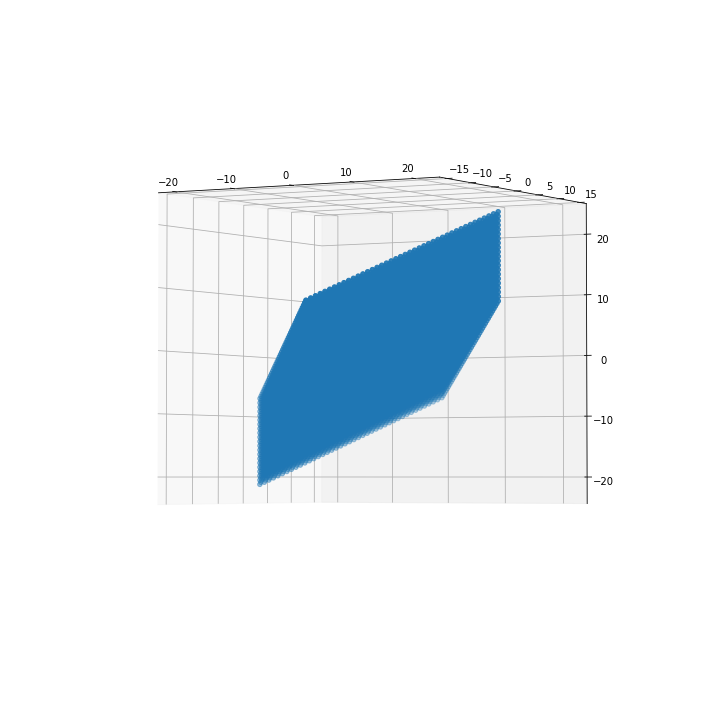

In [155]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(xx,yy,zz)
plt.show()


In [157]:
ene=11;
indices=a0*np.arange(-ene/2+1,ene/2+1)
# type A plane
cubicA_x, cubicA_y, cubicA_z =np.meshgrid(indices,indices,indices)
# type B plane
#cubicB_x= cubicA_x + 1/2.* np.array([a0,0,a0]) 
cubicB_x, cubicB_y, cubicB_z= cubicA_x + 1/2.* a0, cubicA_y, cubicA_z + 1/2.* a0
cubicC_x, cubicC_y, cubicC_z= cubicA_x - 1/2.* a0, cubicA_y + 1/2.* a0 , cubicA_z
cubicD_x, cubicD_y, cubicD_z= cubicC_x + 1/2.* a0, cubicC_y  , cubicC_z - 1/2.* a0
# make rotation
cubicA_x, cubicA_y, cubicA_z = cubicA_x, 1./np.sqrt(2)*(cubicA_y - cubicA_z), 1./np.sqrt(2)*(cubicA_y + cubicA_z)
cubicB_x, cubicB_y, cubicB_z = cubicB_x, 1./np.sqrt(2)*(cubicB_y - cubicB_z), 1./np.sqrt(2)*(cubicB_y + cubicB_z)
cubicC_x, cubicC_y, cubicC_z = cubicC_x, 1./np.sqrt(2)*(cubicC_y - cubicC_z), 1./np.sqrt(2)*(cubicC_y + cubicC_z)
cubicD_x, cubicD_y, cubicD_z = cubicD_x, 1./np.sqrt(2)*(cubicD_y - cubicD_z), 1./np.sqrt(2)*(cubicD_y + cubicD_z)


In [158]:
Rx = np.array([[1,0,0],[0,np.cos(pi/4.),-np.sin(pi/4.)],[0,np.sin(pi/4.),np.cos(pi/4.)]])


<IPython.core.display.Javascript object>


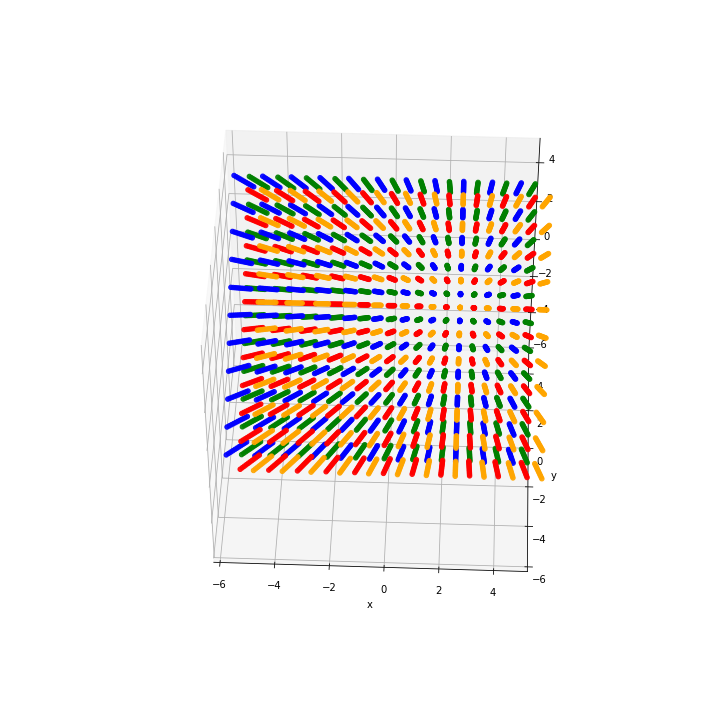

In [159]:
smallalpha=0.9
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')
#ax.scatter(cubicA_x[0],cubicA_y[0],cubicA_z[0])
# ax.scatter(cubicA_x[0],cubicA_y[0],cubicA_z[0],color='red')
# ax.scatter(cubicB_x[0],cubicB_y[0],cubicB_z[0],color='orange')
# ax.scatter(cubicC_x[0],cubicC_y[0],cubicC_z[0],color='blue')
# ax.scatter(cubicD_x[0],cubicD_y[0],cubicD_z[0],color='green')
ax.scatter(cubicA_x,cubicA_y,cubicA_z,color='red',alpha=smallalpha)
ax.scatter(cubicB_x,cubicB_y,cubicB_z,color='orange',alpha=smallalpha)
ax.scatter(cubicC_x,cubicC_y,cubicC_z,color='blue',alpha=smallalpha)
ax.scatter(cubicD_x,cubicD_y,cubicD_z,color='green',alpha=smallalpha)
ax.scatter([0],[0],[0],color='black',alpha=0.5)
ax.scatter([0],[0],[a0/np.sqrt(2)],color='black',alpha=0.7)
plt.xlabel('x')
plt.ylabel('y')
ax.set_xlim(-ene/2,ene/2)
ax.set_ylim(-ene/2,ene/2)
ax.set_zlim(-ene/2,ene/2)
plt.show()

In [160]:
lattice_x=np.concatenate((cubicA_x,cubicB_x,cubicC_x,cubicD_x),axis=0)
lattice_y=np.concatenate((cubicA_y,cubicB_y,cubicC_y,cubicD_y),axis=0)
lattice_z=np.concatenate((cubicA_z,cubicB_z,cubicC_z,cubicD_z),axis=0)

<IPython.core.display.Javascript object>


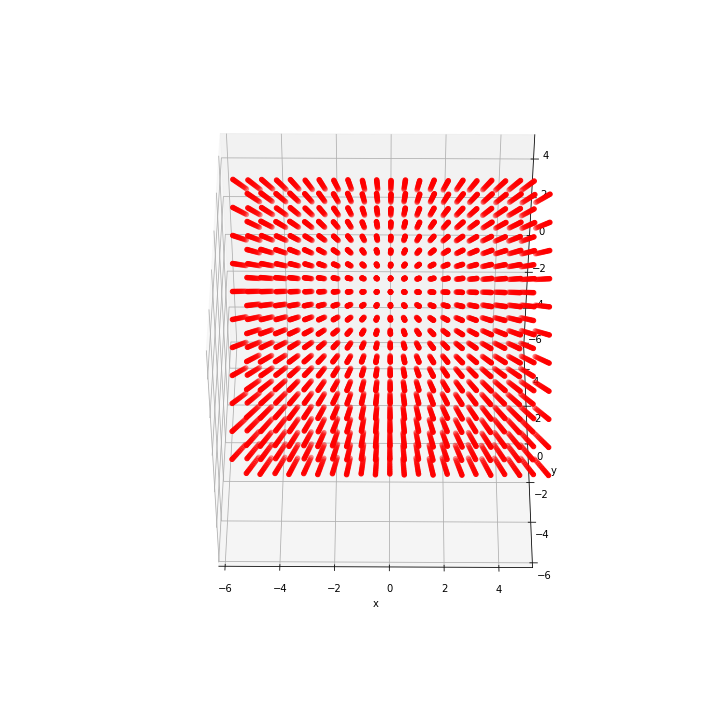

In [161]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')
#ax.scatter(cubicA_x[0],cubicA_y[0],cubicA_z[0])
# ax.scatter(cubicA_x[0],cubicA_y[0],cubicA_z[0],color='red')
# ax.scatter(cubicB_x[0],cubicB_y[0],cubicB_z[0],color='orange')
# ax.scatter(cubicC_x[0],cubicC_y[0],cubicC_z[0],color='blue')
# ax.scatter(cubicD_x[0],cubicD_y[0],cubicD_z[0],color='green')
ax.scatter(lattice_x,lattice_y,lattice_z,color='red')
#ax.scatter(cubicD_x[0],cubicD_y[0],cubicD_z[0])
plt.xlabel('x')
plt.ylabel('y')
ax.set_xlim(-ene/2,ene/2)
ax.set_ylim(-ene/2,ene/2)
ax.set_zlim(-ene/2,ene/2)
plt.show()

In [162]:
r = np.sqrt(lattice_x**2+lattice_y**2+lattice_z**2) # evalates the distances to the vacancy
costheta = np.where(r !=0., lattice_z/r, np.NaN) # calculates the angles
sintheta = np.where(r !=0., np.sqrt(lattice_x ** 2 + lattice_y ** 2)/r,np.NaN)
A = np.where(r !=0., (3 * costheta ** 2 - 1)/(r ** 3),np.NaN)
A = A[~np.isnan(A)]
As = np.reshape(A,(-1));
B = np.where(r !=0.,hyperfine_prefactor * 3 * costheta * sintheta /(r ** 3),np.NaN)
# Careful, these contain both a 0 for the origin, and the value for the Nitrogen atom

/Users/juan/anaconda/envs/python2/lib/python2.7/site-packages/ipykernel/__main__.py:2: RuntimeWarning: invalid value encountered in divide
  from ipykernel import kernelapp as app
/Users/juan/anaconda/envs/python2/lib/python2.7/site-packages/ipykernel/__main__.py:3: RuntimeWarning: invalid value encountered in divide
  app.launch_new_instance()


<IPython.core.display.Javascript object>


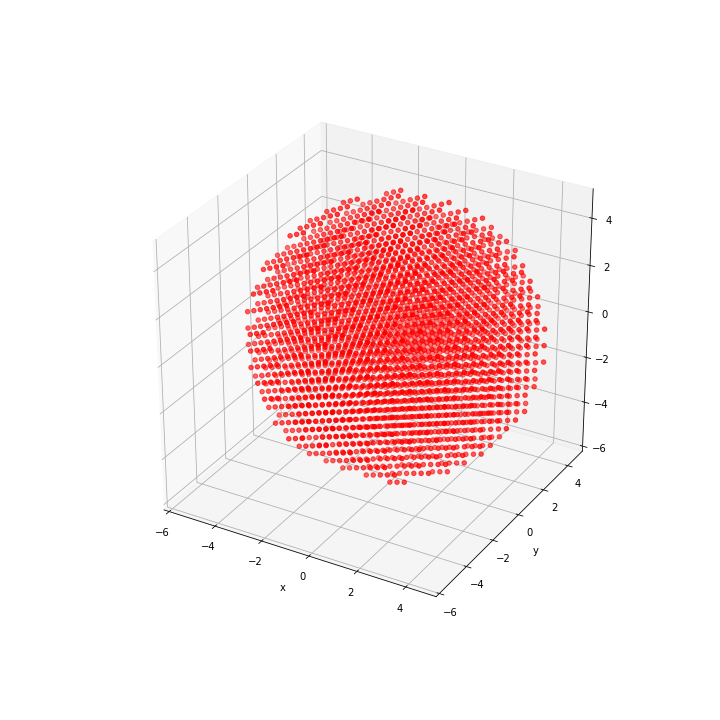

In [163]:
r_max=ene/2.;
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')
#ax.scatter(cubicA_x[0],cubicA_y[0],cubicA_z[0])
# ax.scatter(cubicA_x[0],cubicA_y[0],cubicA_z[0],color='red')
# ax.scatter(cubicB_x[0],cubicB_y[0],cubicB_z[0],color='orange')
# ax.scatter(cubicC_x[0],cubicC_y[0],cubicC_z[0],color='blue')
# ax.scatter(cubicD_x[0],cubicD_y[0],cubicD_z[0],color='green')
ax.scatter(lattice_x[r<r_max],lattice_y[r<r_max],lattice_z[r<r_max],color='red')
#ax.scatter(cubicD_x[0],cubicD_y[0],cubicD_z[0])
plt.xlabel('x')
plt.ylabel('y')
ax.set_xlim(-ene/2,ene/2)
ax.set_ylim(-ene/2,ene/2)
ax.set_zlim(-ene/2,ene/2)
plt.show()

5324

array([ 0.64635983,  0.59308453,  0.0739183 , ...,  0.98328596,
        0.91403163,  0.28507031])

In [164]:
import itertools

In [165]:
r_max=ene/2.;
dice=np.random.rand(np.product(np.shape(lattice_x)));
abundancy=0.5; #abundancy of carbon 13
for i in range(np.)
fig = plt.figure(figsize=(10,10))
carbon12=
ax = fig.add_subplot(111, projection='3d')
ax.scatter(lattice_x[r<r_max],lattice_y[r<r_max],lattice_z[r<r_max],color='red')
#ax.scatter(cubicD_x[0],cubicD_y[0],cubicD_z[0])
plt.xlabel('x')
plt.ylabel('y')
ax.set_xlim(-ene/2,ene/2)
ax.set_ylim(-ene/2,ene/2)
ax.set_zlim(-ene/2,ene/2)
plt.show()

SyntaxError: invalid syntax (<ipython-input-165-199563dca15f>, line 4)

2779

<IPython.core.display.Javascript object>


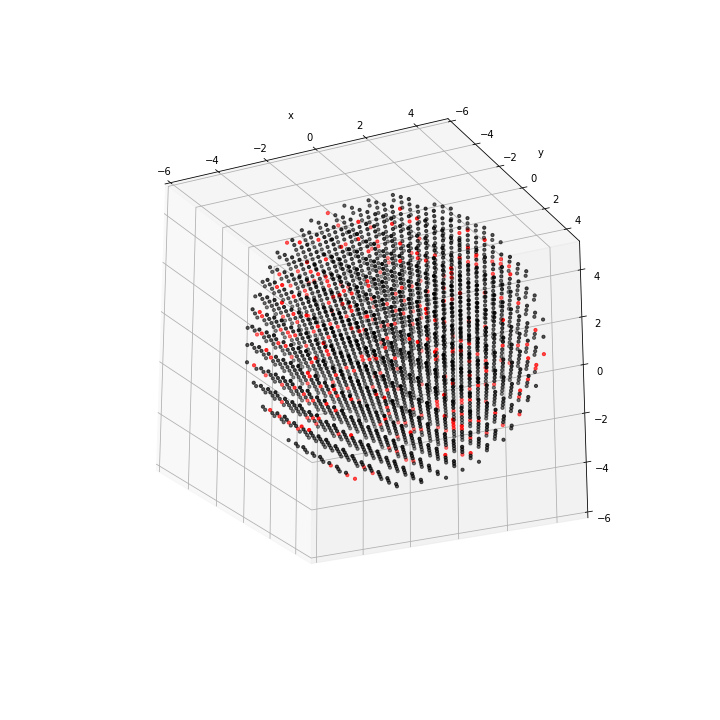

In [166]:
atoms=np.stack((lattice_x[r<r_max],lattice_y[r<r_max],lattice_z[r<r_max]),axis=-1)
atoms=np.reshape(atoms,(np.product(np.shape(lattice_x[r<r_max])),3))
dice=np.random.rand(np.product(np.shape(lattice_x[r<r_max])));
abundancy=0.1; #abundancy of carbon 13
carbon13=atoms[dice<abundancy];
carbon12=atoms[dice>=abundancy];
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(*zip(*carbon13),color='red',s=10)
ax.scatter(*zip(*carbon12),color='black',s=10)
#ax.scatter(cubicD_x[0],cubicD_y[0],cubicD_z[0])
plt.xlabel('x')
plt.ylabel('y')
ax.set_xlim(-ene/2,ene/2)
ax.set_ylim(-ene/2,ene/2)
ax.set_zlim(-ene/2,ene/2)
plt.show()

In [ ]:
indices_m=range(2*(-ene/2+1),2*(ene/2+1))
indices_n=range(2*(-ene/2+1),2*(ene/2+1))
xxi, yyi, zzi = np.meshgrid(indices_l,indices_m,indices_n)
xx = xxi*i[0] + yyi*j[0] + zzi*k[0]
yy = xxi*i[1] + yyi*j[1] + zzi*k[1]
zz = xxi*i[2] + yyi*j[2] + zzi*k[2]
r = np.sqrt(xx**2+yy**2+zz**2) # evalates the distances to the vacancy
costheta = zz/r # calculates the angles

In [271]:
xt,yt=np.meshgrid(np.arange(-1,2),np.arange(-1,2))

In [276]:
xt2,yt2=np.meshgrid(np.arange(-0.5,2.5),np.arange(-0.5,2.5))

In [277]:
xt2

array([[-0.5,  0.5,  1.5],
       [-0.5,  0.5,  1.5],
       [-0.5,  0.5,  1.5]])

In [285]:
np.sort(np.concatenate((xt2[0],xt[0])))

array([-1. , -0.5,  0. ,  0.5,  1. ,  1.5])

In [292]:
np.array([np.sort(np.concatenate((xt2[0],xt[0])))])

array([[-1. , -0.5,  0. ,  0.5,  1. ,  1.5]])

In [295]:
np.repeat(np.array([np.sort(np.concatenate((xt2[0],xt[0])))]),6,axis=0)

array([[-1. , -0.5,  0. ,  0.5,  1. ,  1.5],
       [-1. , -0.5,  0. ,  0.5,  1. ,  1.5],
       [-1. , -0.5,  0. ,  0.5,  1. ,  1.5],
       [-1. , -0.5,  0. ,  0.5,  1. ,  1.5],
       [-1. , -0.5,  0. ,  0.5,  1. ,  1.5],
       [-1. , -0.5,  0. ,  0.5,  1. ,  1.5]])

In [297]:
ene=11;
indices=a0*np.linspace(-ene/2+1,ene/2+1,1/2)
# type A plane
cubicA_x, cubicA_y, cubicA_z =np.meshgrid(indices,indices,indices)

In [300]:
np.linspace(-ene/2.,ene/2.,1/2.)

array([], dtype=float64)

## What Michael had

In [202]:
import numpy as np
import itertools

# For explanation of the formulas used here, see chapter 2 of thesis.

# Constants
# lattice constant of diamond
a0 = 3.567 * 10 ** (-10) # in meters
# Hyperfine coupling related constants
gam_el = -1.760859 * 10 ** 11 # Gyromagnetic ratio for a single electron in rad s-1 T-1
gam_n = 67.262 * 10 ** 6 # Gyromagnetic ratio for a single c13 nucleus in rad s-1 T-1
hbar = 1.05457173 * 10 ** (-34)
pi = np.pi
h = hbar * 2 * pi
mu0 = 4 * pi * 10 ** (-7)

# Carbon Lattice Definition
# Basis vectors
# i, j, k are basis vectors of Face Centered Cubic Bravais lattice
i = a0/2*np.array([0,1,1])
j = a0/2*np.array([1,0,1])
k = a0/2*np.array([1,1,0])
# a and b are the relative positions of the nitrogen and vacancy
a = np.array([0,0,0])
b = a0/4*np.array([1,1,1])
# rotate all the vectors so that the symmetry axis (b) of the NV center is along the z direction
# rotation around z axis by pi/4 puts b in yz plane
Rz = np.array([[np.cos(pi/4),-np.sin(pi/4),0],[np.sin(pi/4),np.cos(pi/4),0],[0,0,1]])
sqrt2angle = np.arctan(np.sqrt(2))
# rotation around x axis by sqrt2angle moves b from yz plane to z axis
Rx = np.array([[1,0,0],[0,np.cos(sqrt2angle),-np.sin(sqrt2angle)],[0,np.sin(sqrt2angle),np.cos(sqrt2angle)]])
b = Rx.dot(Rz).dot(b)
i = Rx.dot(Rz).dot(i)
j = Rx.dot(Rz).dot(j)
k = Rx.dot(Rz).dot(k)

hyperfine_prefactor = -1 * mu0 * gam_el * gam_n * hbar/(4 * pi) # Only one hbar instead of hbar ** 2 since we convert to angular frequency units in the hamiltonian.

# Takes Carbon Concentration, and gridsize (N) as inputs
# Returns a list of 2D numpy arrays with hyperfine couplings of c13 nuclei to the NV center in angular frequency Hz
# If sphere is true the c13 nuclei inside a sphere are returned instead of those inside a cube.	
#def generate_NV(c13_concentration=0.011,N=25,sphere = True):
def generate_NV(c13_concentration=0.9,N=25,sphere = True):
	# define position of NV in middle of the grid
	center = round(N/2)
	NVPos = center * i + center * j + center * k
	global spin_list
	spin_list = []
	#Calculate hyperfine strength for all gridpoints
	for n, m, l in itertools.product(range(N), repeat = 3):
		if (n,m,l) != (center, center, center): # all lattice pairs except the nitrogen and vacancy
			lattice_position = n * i + m * j + l * k - NVPos # relative position of a lattice point to the NV center
			for pos in [lattice_position, lattice_position + b]: # the two lattice positions at this grid location
				x, y, z = pos
				r = np.sqrt(pos.dot(pos))
				costheta = z/r
				sintheta = np.sqrt(x ** 2 + y ** 2)/r
				A = hyperfine_prefactor * (3 * costheta ** 2 - 1)/(r ** 3)
				B = hyperfine_prefactor * 3 * costheta * sintheta /(r ** 3)
				spin_list.append((r, A, B, costheta, sintheta, x, y, z))

	if sphere:
		spin_list.sort() # sort by r value from smallest to largest
		spin_list = spin_list[:len(spin_list)/1] # keep the closest half of the spins

	# for each lattice point, let it be a c13 with probability c13_concentration 
	c13_inds = np.where(np.random.rand(len(spin_list))<c13_concentration)[0]
	c13_spins = np.array(spin_list)[c13_inds]
	r, A, B, costheta, sintheta, xx, yy, zz = zip(*c13_spins)
	return np.array(xx), np.array(yy), np.array(zz)#np.array(A), np.array(B), np.array(r), np.array(costheta), np.array(sintheta)

# Generates C13s near a NV center. The number of C13s is roughly num_spins if N==None.
# If enforce_bound = True, the random generation will repeat until there are no couplings greater than coupling_bound.
def generate_spins(num_spins, enforce_bound = True, coupling_bound = 150 * 2 * pi * 1e3, c13_concentration = 0.011, N = None, abs_val = False, verbose = False):
	if N == None:
		N = int(np.ceil(((num_spins*1.0)/c13_concentration) ** (1.0/3)))
	if verbose:
		print "N:", N
	A, B, r, costheta, sintheta = generate_NV(N = N, c13_concentration = c13_concentration)
	while enforce_bound and (np.any(A ** 2 + B ** 2 > (coupling_bound) ** 2)):
		A, B, r, costheta, sintheta = generate_NV(N = N, c13_concentration = c13_concentration)
	if abs_val:
		B = np.abs(B)
	return A, B, r, costheta, sintheta


In [203]:
sxx,syy,szz=generate_NV()

<IPython.core.display.Javascript object>


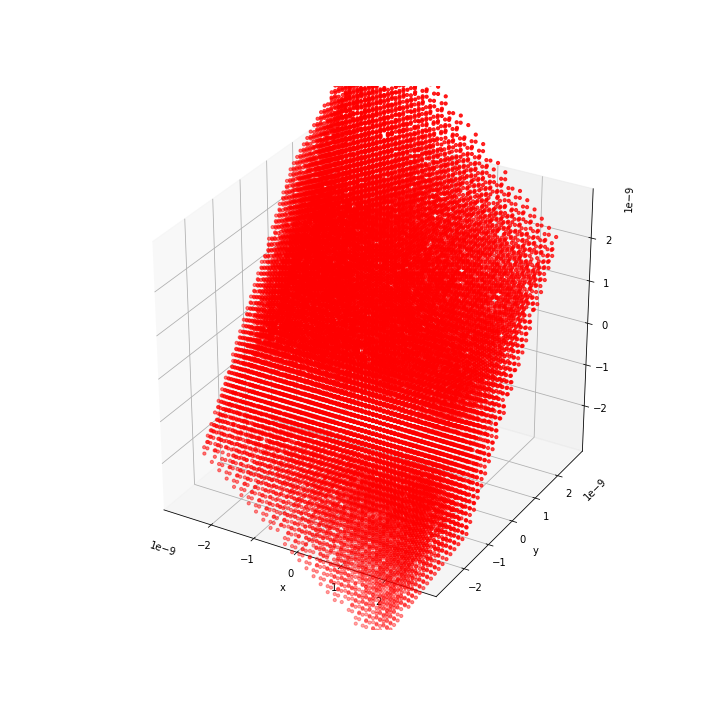

In [204]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(sxx,syy,szz,color='red',s=10)
#ax.scatter(*zip(*carbon12),color='black',s=10)
#ax.scatter(cubicD_x[0],cubicD_y[0],cubicD_z[0])
plt.xlabel('x')
plt.ylabel('y')
ax.set_xlim(-3e-9,3e-9)
ax.set_ylim(-3e-9,3e-9)
ax.set_zlim(-3e-9,3e-9)
plt.show()

In [174]:
spin_list

[(1.5445563076495455e-10,
  -22597895.080115944,
  -31958249.703383841,
  -0.33333333333333126,
  0.94280904158206402),
 (1.5445563076495455e-10,
  -22597895.080115944,
  -31958249.703383841,
  -0.33333333333333126,
  0.94280904158206402),
 (1.5445563076495463e-10,
  -22597895.080115929,
  -31958249.703383774,
  -0.33333333333333109,
  0.94280904158206402),
 (2.5222498884924125e-10,
  7784059.5291422876,
  -11008322.556432588,
  -0.81649658092772548,
  0.57735026918962651),
 (2.5222498884924125e-10,
  7784059.5291422876,
  -11008322.556432588,
  -0.81649658092772548,
  0.57735026918962651),
 (2.5222498884924131e-10,
  7784059.5291422736,
  -11008322.556432579,
  -0.81649658092772526,
  0.57735026918962662),
 (2.5222498884924151e-10, -7784059.5291422838, 0.0, 0.0, 1.0),
 (2.5222498884924151e-10, -7784059.5291422838, 0.0, 0.0, 1.0),
 (2.5222498884924167e-10, -7784059.5291422699, 0.0, 0.0, 1.0),
 (2.5222498884924167e-10, -7784059.5291422699, 0.0, 0.0, 1.0),
 (2.5222498884924167e-10,
  -77

In [126]:
# Test

In [127]:
# NV-spin-tomography Michael Scheer mgscheer@gmail.com

# generating random NV centers

import numpy as np
import itertools

# For explanation of the formulas used here, see chapter 2 of thesis.

# Constants
# lattice constant of diamond
a0 = 3.567 * 10 ** (-10) # in meters
# Hyperfine coupling related constants
gam_el = -1.760859 * 10 ** 11 # Gyromagnetic ratio for a single electron in rad s-1 T-1
gam_n = 67.262 * 10 ** 6 # Gyromagnetic ratio for a single c13 nucleus in rad s-1 T-1
hbar = 1.05457173 * 10 ** (-34)
pi = np.pi
h = hbar * 2 * pi
mu0 = 4 * pi * 10 ** (-7)

# Carbon Lattice Definition
# Basis vectors
# i, j, k are basis vectors of Face Centered Cubic Bravais lattice
i = a0/2*np.array([0,1,1])
j = a0/2*np.array([1,0,1])
k = a0/2*np.array([1,1,0])
# a and b are the relative positions of the nitrogen and vacancy
a = np.array([0,0,0])
b = a0/4*np.array([1,1,1])
# rotate all the vectors so that the symmetry axis (b) of the NV center is along the z direction
# rotation around z axis by pi/4 puts b in yz plane
Rz = np.array([[np.cos(pi/4),-np.sin(pi/4),0],[np.sin(pi/4),np.cos(pi/4),0],[0,0,1]])
sqrt2angle = np.arctan(np.sqrt(2))
# rotation around x axis by sqrt2angle moves b from yz plane to z axis
Rx = np.array([[1,0,0],[0,np.cos(sqrt2angle),-np.sin(sqrt2angle)],[0,np.sin(sqrt2angle),np.cos(sqrt2angle)]])
b = Rx.dot(Rz).dot(b)
i = Rx.dot(Rz).dot(i)
j = Rx.dot(Rz).dot(j)
k = Rx.dot(Rz).dot(k)

hyperfine_prefactor = -1 * mu0 * gam_el * gam_n * hbar/(4 * pi) # Only one hbar instead of hbar ** 2 since we convert to angular frequency units in the hamiltonian.

# Takes Carbon Concentration, and gridsize (N) as inputs
# Returns a list of 2D numpy arrays with hyperfine couplings of c13 nuclei to the NV center in angular frequency Hz
# If sphere is true the c13 nuclei inside a sphere are returned instead of those inside a cube.	
def generate_NV(c13_concentration=0.011,N=25,sphere = True):
	# define position of NV in middle of the grid
	center = round(N/2)
	NVPos = center * i + center * j + center * k

	spin_list = []
	#Calculate hyperfine strength for all gridpoints
	for n, m, l in itertools.product(range(N), repeat = 3):
		if (n,m,l) != (center, center, center): # all lattice pairs except the nitrogen and vacancy
			lattice_position = n * i + m * j + l * k - NVPos # relative position of a lattice point to the NV center
			for pos in [lattice_position, lattice_position + b]: # the two lattice positions at this grid location
				x, y, z = pos
				r = np.sqrt(pos.dot(pos))
				costheta = z/r
				sintheta = np.sqrt(x ** 2 + y ** 2)/r
				A = hyperfine_prefactor * (3 * costheta ** 2 - 1)/(r ** 3)
				B = hyperfine_prefactor * 3 * costheta * sintheta /(r ** 3)
				spin_list.append((r, A, B, costheta, sintheta))

	if sphere:
		spin_list.sort() # sort by r value from smallest to largest
		spin_list = spin_list[:len(spin_list)/2] # keep the closest half of the spins

	# for each lattice point, let it be a c13 with probability c13_concentration 
	c13_inds = np.where(np.random.rand(len(spin_list))<c13_concentration)[0]
	c13_spins = np.array(spin_list)[c13_inds]
	r, A, B, costheta, sintheta = zip(*c13_spins)
	return np.array(A), np.array(B), np.array(r), np.array(costheta), np.array(sintheta)

# Generates C13s near a NV center. The number of C13s is roughly num_spins if N==None.
# If enforce_bound = True, the random generation will repeat until there are no couplings greater than coupling_bound.
def generate_spins(num_spins, enforce_bound = True, coupling_bound = 150 * 2 * pi * 1e3, c13_concentration = 0.011, N = None, abs_val = False, verbose = False):
	if N == None:
		N = int(np.ceil(((num_spins*1.0)/c13_concentration) ** (1.0/3)))
	if verbose:
		print "N:", N
	A, B, r, costheta, sintheta = generate_NV(N = N, c13_concentration = c13_concentration)
	while enforce_bound and (np.any(A ** 2 + B ** 2 > (coupling_bound) ** 2)):
		A, B, r, costheta, sintheta = generate_NV(N = N, c13_concentration = c13_concentration)
	if abs_val:
		B = np.abs(B)
	return A#, B, r, costheta, sintheta

In [136]:
trials=[]
for i in range(100):
    trials.append(np.shape(generate_spins(100))[1])

/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:59: RuntimeWarning: invalid value encountered in double_scalars
/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:60: RuntimeWarning: invalid value encountered in double_scalars
/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:83: RuntimeWarning: invalid value encountered in greater


KeyboardInterrupt: 

In [135]:
sum(trials)

115